<!-- # CNN autoencoder and Clustering from MTRX data

Use this notebook to load Scienta Omicron Matrix format SPM data and create standardised images for machine learning training and analysis. The code can generate both JPG image data, useful for manually checking the data, and windowed numpy data that can be loaded into ML models. 

The notebook then creates an autoencoder for training on a large dataset, followed by KMEANS clustering. 

**Author**: Steven R. Schofield  
**Created**: November, 2024 -->

# Machine learning autoencoder + Kmeans for STM image data analysis
## Steven R. Schofield (Universtiy College London) Dec. 2024.

### Load required modules

In [ ]:
# Define path where to find the module. This allows for a different path depending on where the code is running (my mac or the cluster)
import os
import sys

# Define candidate paths
module_path_list = [
    '/Users/steven/academic-iCloud/Python/modules',
    '/hpc/aklicka/Python/modules'
]

data_path_list = [
    '/Users/steven/Python-data',
    '/hpc/aklicka/Python-data/training-set-1'
]

# Resolve actual paths
module_path = next((p for p in module_path_list if os.path.exists(p)), None)
data_path = next((p for p in data_path_list if os.path.exists(p)), None)

# Check and report missing paths
if module_path is None:
    print("Error: Could not locate a valid module path.")
if data_path is None:
    print("Error: Could not locate a valid data path.")

if module_path is None or data_path is None:
    sys.exit(1)

# Print resolved paths
print(f"module_path = {module_path}")
print(f"data_path = {data_path}")

# Reduce TensorFlow verbosity
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'


module_path = /hpc/aklicka/Python/modules
data_path = /hpc/aklicka/Python-data/training-set-1


In [2]:
# # Ensure modules are reloaded 
%load_ext autoreload
%autoreload 2

# Import standard modules
import numpy as np

import platform

from datetime import datetime

# Add custom module path to list
sys.path.append(module_path)

# Import custom module
import SRSML24.data_prep as dp
import SRSML24.model as m
import SRSML24.utils as ut

import tensorflow as tf
#from tensorflow.keras.optimizers.legacy import Adam 
from tensorflow.keras.optimizers import Adam

import matplotlib.pyplot as plt

import pandas as pd
from IPython.display import display, Markdown

#import platform 

m.print_system_info()

start_time = dp.current_datetime()

ModuleNotFoundError: No module named 'SRSML24.data_processing'

### Programme variable setup

In [ ]:
# Parameters for windows creation
# General
job_name = 'June_25'
verbose = False             # Set this True to print out more information

# MTRX preprocessing
flatten_method = 'poly_xy'
pixel_density = 15.0        # Convert all images to a constant pixel density
pixel_ratio = 0.7           # If an image has less than this % in the slow scan direction it is discarded
data_scaling = 1.e9         # Scale the z-height of the data

# Windowing
window_size = 32            # Window size for training/validation
window_pitch = 8            # Window pitch for training/validation

# Data saving options
save_windows = True         # Save the windows as numpy files
together = True             # Set this True to save image windows for a mtrx image as a single file rather than separate files.
save_jpg = False            # Save the full image as a jpg
collate = False             # Set this True to remove all subfolder directories and save all data in root data path
save_window_jpgs = False    # Save the windows as jpgs for inspection

# Parameters for training
model_name = 'unet_' + job_name
batch_size = 128
buffer_size = 12800 # shuffling
learning_rate = 1e-4
epochs = 5

# Parameters for clustering
cluster_model_name = model_name + '_kmeans'
cluster_batch_size = 5120 # This is the number of latent features in a batch for clustering. 
                          # Does not have to be the same as for training and probably should 
                          # be larger. 
cluster_buffer_size = cluster_batch_size * 5    # shuffling buffer
num_clusters=20                                 # Desired number of clusters (centroids) to form in the data.
max_iter=1000                                   # Maximum iterations allowed for each mini-batch to refine centroids.
reassignment_ratio=0.05                         # Fraction of clusters reassigned per step; lower values stabilize updates.

# Parameters for PREDICTIONS
predict_window_pitch = 2                        # Window pitch for prediction
predictions_batch_size = 2**15                  # Batch size for predictions


# DATA LIMITS FOR TESTING THE CODE
mtrx_train_data_limit = 200                    # Number of MTRX files to process (training)
mtrx_test_data_limit = 50                     # Number of MTRX files to process (validation)

train_data_limit = None                         # Limit the data used in the autoencoder training
test_data_limit = None                          # Limit the data used in the autoencoder training (validation)

In [5]:
job_data_path = dp.create_new_data_path(data_path, job_name, include_date=False)

mtrx_train_path = os.path.join(data_path, 'mtrx/train')
mtrx_test_path = os.path.join(data_path, 'mtrx/test')
mtrx_predict_path = os.path.join(data_path, 'mtrx/predict')

model_path = os.path.join(job_data_path,'model')
cluster_model_path = os.path.join(job_data_path,'cluster_model')

latent_features_path = os.path.join(job_data_path, 'latent_features')
predict_latent_features_path = os.path.join(job_data_path, 'latent_features_predictions')

windows_train_path = os.path.join(job_data_path, 'windows/train')
windows_test_path = os.path.join(job_data_path, 'windows/test')
windows_predict_path = os.path.join(job_data_path, 'windows/predict')

predictions_path = os.path.join(job_data_path, f'predictions')

### Process Matrix format data to windows for autoencoder training and validation

In [7]:
# REMOVE ALL DATA FOLDERS EXCEPT MTRX 
dp.delete_data_folders(job_data_path, subdirectories=["jpg", "windows", "windows-jpg"], override=True)

Deleted: /hpc/aklicka/Python-data/training-set-1/June_25/windows
All specified folders have been successfully deleted.


In [9]:
# Training data
mtrx_train_file_list, _ = dp.list_files_by_extension(mtrx_train_path,'Z_mtrx',verbose=False)

dp.process_mtrx_files(
    mtrx_train_file_list[0:mtrx_train_data_limit],
    job_data_path, # save data path
    flatten_method = flatten_method, pixel_density = pixel_density, pixel_ratio = pixel_ratio,
    data_scaling = data_scaling, window_size = window_size, window_pitch = window_pitch,
    save_windows = save_windows,
    save_window_jpgs=save_window_jpgs,
    save_jpg = save_jpg,
    together = together,
    collate = collate,
    verbose = verbose
    )

# Test data
mtrx_test_file_list, _ = dp.list_files_by_extension(mtrx_test_path,'Z_mtrx',verbose=False)

dp.process_mtrx_files(
    mtrx_test_file_list[0:mtrx_test_data_limit],
    job_data_path, # save data path
    flatten_method = flatten_method, pixel_density = pixel_density, pixel_ratio = pixel_ratio,
    data_scaling = data_scaling, window_size = window_size, window_pitch = window_pitch,
    save_windows = save_windows,
    save_window_jpgs=save_window_jpgs,
    save_jpg = save_jpg,
    together = together,
    collate = collate,
    verbose = verbose
    )

Found 1973 files with extension 'Z_mtrx' in directory:
/hpc/aklicka/Python-data/training-set-1/mtrx/train
There are 200 files to process
....t...t....t....................t.t............ttt.......t.......t.....ttt.t............tt..tttt. 100
t........t......ttt..t..tt.ttt.........t..t....tt.t.tt..tt...tttttttttttttttttttttt.ttt.ttt.tt..ttt 200
t
********************
Conversion complete.
********************

Found 452 files with extension 'Z_mtrx' in directory:
/hpc/aklicka/Python-data/training-set-1/mtrx/test
There are 50 files to process
..t.....................t.t.....t.................
********************
Conversion complete.
********************



### Build tensorflow data pipeline for training and validation of autoencoder

In [10]:
# Training data - tensorflow data pipeline for autoencoder
train_files, num_train = dp.list_files_by_extension(windows_train_path, 'npy')
train_files = train_files[:train_data_limit]

# Create dataset with prefetching
train_dataset = m.create_tf_dataset_batched(
    train_files, 
    batch_size=batch_size, 
    buffer_size=buffer_size, 
    window_size=window_size,
    is_autoencoder=True, 
    shuffle=True)

# Validation data - tensorflow data pipeline for autoencoder
test_files, num_test = dp.list_files_by_extension(windows_test_path, 'npy')
test_files = test_files[:test_data_limit]

# Create dataset with prefetching
test_dataset = m.create_tf_dataset_batched(
    test_files, 
    batch_size=batch_size, 
    buffer_size=buffer_size, 
    window_size=window_size,
    is_autoencoder=True, 
    shuffle=True)

Found 217 files with extension 'npy' in directory:
/hpc/aklicka/Python-data/training-set-1/June_25/windows/train
Data pipeline created with 217 files, batch size: 128, window size: 32
Sample batch shape: (128, 32, 32, 1)

Found 8 files with extension 'npy' in directory:
/hpc/aklicka/Python-data/training-set-1/June_25/windows/test
Data pipeline created with 8 files, batch size: 128, window size: 32
Sample batch shape: (128, 32, 32, 1)



In [11]:
# Build and compile the UNET model
autoencoder_model = m.build_autoencoder(window_size=window_size,model_name=model_name)
autoencoder_model.summary()
m.save_model_summary(autoencoder_model, model_path, model_name=model_name)

# Can also save a graphical representation of the model
# This requires pydot and graphviz to be installed
# pip install pydot
# pip install graphviz
# If you are using a Mac, you may need to install graphviz using brew
# brew install graphviz
m.save_model_diagram(autoencoder_model, model_path, model_name=model_name, show_shapes=False, show_layer_names=False, expand_nested=False)

# Check if running on Apple Silicon
is_mac_silicon = platform.system() == "Darwin" and platform.processor() == "arm"

if is_mac_silicon:
    print("Detected Mac with Apple Silicon. Compiling the model with the legacy RMSprop optimizer for compatibility with TensorFlow-metal.")
    autoencoder_model.compile(
        optimizer=tf.keras.optimizers.legacy.RMSprop(learning_rate=learning_rate),
        loss='mean_squared_error',
        metrics=['mse', 'mae']
    )
else:
    print("Compiling the model with the RMSprop optimizer.")
    autoencoder_model.compile(
        optimizer=tf.keras.optimizers.RMSprop(learning_rate=learning_rate),
        loss='mean_squared_error',
        metrics=['mse', 'mae']
    )



Model: "unet_June_25"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input (InputLayer)              [(None, 32, 32, 1)]  0                                            
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 32, 32, 32)   320         input[0][0]                      
__________________________________________________________________________________________________
drop1 (Dropout)                 (None, 32, 32, 32)   0           conv1[0][0]                      
__________________________________________________________________________________________________
pool1 (MaxPooling2D)            (None, 16, 16, 32)   0           drop1[0][0]                      
_______________________________________________________________________________________

### Train autoencoder

In [12]:
# Train the model using the tf.data datasets
history = autoencoder_model.fit(
    train_dataset,
    validation_data=test_dataset,
    epochs=epochs,
    shuffle=True,
    verbose=1
)
model_train_time = datetime.now().strftime('%Y%m%d_%H%M%S')
print(f"Model training completed at {model_train_time}")

# Save the model as soon as training completes
m.save_model(autoencoder_model, model_path, model_name=model_name, model_train_time=model_train_time)

end_time = dp.current_datetime()
dp.elapsed_time(start_time,end_time)

Epoch 1/5
5959/5959 [==============================] - 352s 58ms/step - loss: 0.0042 - mse: 0.0042 - mae: 0.0419 - val_loss: 1.8779e-04 - val_mse: 1.8779e-04 - val_mae: 0.0107
Epoch 2/5
5959/5959 [==============================] - 994s 167ms/step - loss: 1.1745e-04 - mse: 1.1745e-04 - mae: 0.0087 - val_loss: 8.1620e-04 - val_mse: 8.1620e-04 - val_mae: 0.0252
Epoch 3/5
5959/5959 [==============================] - 1095s 184ms/step - loss: 6.2857e-05 - mse: 6.2857e-05 - mae: 0.0065 - val_loss: 2.2328e-04 - val_mse: 2.2328e-04 - val_mae: 0.0113
Epoch 4/5
5959/5959 [==============================] - 1260s 211ms/step - loss: 4.2697e-05 - mse: 4.2697e-05 - mae: 0.0054 - val_loss: 3.5249e-04 - val_mse: 3.5249e-04 - val_mae: 0.0162
Epoch 5/5
5959/5959 [==============================] - 1279s 215ms/step - loss: 3.1497e-05 - mse: 3.1497e-05 - mae: 0.0046 - val_loss: 9.5175e-05 - val_mse: 9.5175e-05 - val_mae: 0.0058
Model training completed at 20250603_104747
Model saved at: /hpc/aklicka/Python-d

### Extract Latent Features

In [13]:
dp.delete_data_folders(
    job_data_path, 
    subdirectories='latent_features',
    override=True)

No target folders found to delete.


In [78]:
# Load the trained autoencoder model
autoencoder_model = m.load_model(model_path, model_name=model_name)

Model loaded from: /hpc/aklicka/Python-data/training-set-1/June_25/model/unet_June_25.keras


In [15]:
# Training data - tensorflow data pipeline 
train_files, num_train = dp.list_files_by_extension(windows_train_path, 'npy')
train_files = train_files[:train_data_limit]

train_dataset = m.create_tf_dataset_batched(
    train_files, 
    batch_size=cluster_batch_size, 
    buffer_size=cluster_buffer_size, 
    window_size=window_size,
    is_autoencoder=True, 
    shuffle=True)

Found 217 files with extension 'npy' in directory:
/hpc/aklicka/Python-data/training-set-1/June_25/windows/train
Data pipeline created with 217 files, batch size: 5120, window size: 32
Sample batch shape: (5120, 32, 32, 1)



In [16]:
m.extract_latent_features_to_disk_from_prebatched_windows(
    autoencoder_model, 
    train_dataset, 
    latent_features_path, 
    bottleneck_layer_name='bottleneck',
    features_name='latent_features_train',
    return_array=False,
    verbose=False)

....................................................................................................100
................................................
All latent features have been saved to /hpc/aklicka/Python-data/training-set-1/June_25/latent_features.
Sample batch shape: (5120, 4096)


### Train KMEANS using latent features saved to disk

In [8]:
# List and sort latent feature files
latent_features_files, num_latent_files = dp.list_files_by_extension(latent_features_path, 'npy')

Found 149 files with extension 'npy' in directory:
/hpc/aklicka/Python-data/training-set-1/June_25/latent_features


In [9]:
# Load the latent features from disk into a tensor dataset pipeline
latent_features_dataset = m.create_latent_features_tf_dataset(
    latent_features_files,
    batch_size=cluster_batch_size,
    shuffle=True, 
    shuffle_buffer_size=cluster_buffer_size)

Data pipeline created with 149 files, batch size: 5120
Shuffling enabled with buffer size: 25600
Batch shape: (5120, 4096)


Batch 1 processed. Inertia: 473.38751220703125
Batch 2 processed. Inertia: 481.4339904785156
Batch 3 processed. Inertia: 474.36279296875
Batch 4 processed. Inertia: 475.2672424316406
Batch 5 processed. Inertia: 481.1620788574219
Batch 6 processed. Inertia: 482.28466796875
Batch 7 processed. Inertia: 482.901123046875
Batch 8 processed. Inertia: 486.3622741699219
Batch 9 processed. Inertia: 485.2319030761719
Batch 10 processed. Inertia: 477.02581787109375
Batch 11 processed. Inertia: 486.781982421875
Batch 12 processed. Inertia: 499.8421325683594
Batch 13 processed. Inertia: 478.03717041015625
Batch 14 processed. Inertia: 487.84259033203125
Batch 15 processed. Inertia: 471.1483459472656
Batch 16 processed. Inertia: 493.69647216796875
Batch 17 processed. Inertia: 490.38592529296875
Batch 18 processed. Inertia: 481.0059814453125
Batch 19 processed. Inertia: 485.26336669921875
Batch 20 processed. Inertia: 495.2498474121094
Batch 21 processed. Inertia: 473.6497802734375
Batch 22 processed. I

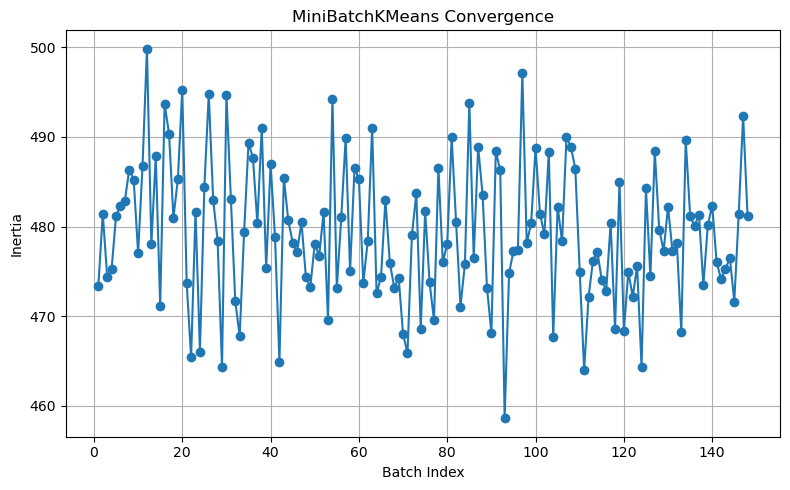

Cluster model saved at: /hpc/aklicka/Python-data/training-set-1/June_25/cluster_model/unet_June_25_kmeans.pkl


In [10]:

cluster_model, convergence_history = m.train_kmeans(
    latent_features_dataset,                # tf.data.Dataset containing batches of latent feature vectors.
    batch_size=cluster_batch_size,          # Size of each batch for the KMeans model (controls memory usage and stability).
    num_clusters=num_clusters,              # Desired number of clusters (centroids) to form in the data.
    max_iter=5000000,                      # Maximum iterations allowed for each mini-batch to refine centroids.
    reassignment_ratio=0.01   # Fraction of clusters reassigned per step; lower values stabilize updates.
)
# Save and plot convergence history
m.plot_kmeans_convergence(convergence_history, cluster_model_path, model_name=cluster_model_name)

# Save cluster model
m.save_cluster_model(cluster_model, cluster_model_path, model_name=cluster_model_name)

In [11]:
print(convergence_history[-1])

449.3005065917969


In [ ]:
#num_cluster_array = np.arange(1, 30)
#inertia_array = []
#
#for i in num_cluster_array:
#    print(f"Training KMeans with {i} clusters")
#    
#    dataset_for_loop = latent_features_dataset
#
#    cluster_model, convergence_history = m.train_kmeans(
#        dataset_for_loop,                # tf.data.Dataset containing batches of latent feature vectors.
#        batch_size=cluster_batch_size,          # Size of each batch for the KMeans model (controls memory usage and stability).
#        num_clusters=i,              # Desired number of clusters (centroids) to form in the data.
#        max_iter=5000000,                      # Maximum iterations allowed for each mini-batch to refine centroids.
#        reassignment_ratio=0.01   # Fraction of clusters reassigned per step; lower values stabilize updates.
#    )
#    inertia_array.append(cluster_model.inertia_)#

Training KMeans with 1 clusters
Batch 1 processed. Inertia: 1059.8292236328125
Batch 2 processed. Inertia: 1085.7464599609375
Batch 3 processed. Inertia: 1068.2813720703125
Batch 4 processed. Inertia: 1040.7105712890625
Batch 5 processed. Inertia: 1078.5986328125
Batch 6 processed. Inertia: 1053.912841796875
Batch 7 processed. Inertia: 1076.1240234375
Batch 8 processed. Inertia: 1076.905517578125
Batch 9 processed. Inertia: 1092.7412109375
Batch 10 processed. Inertia: 1075.795166015625
Batch 11 processed. Inertia: 1081.658935546875
Batch 12 processed. Inertia: 1096.9742431640625
Batch 13 processed. Inertia: 1064.6444091796875
Batch 14 processed. Inertia: 1090.778076171875
Batch 15 processed. Inertia: 1051.6170654296875
Batch 16 processed. Inertia: 1087.273681640625
Batch 17 processed. Inertia: 1064.4345703125
Batch 18 processed. Inertia: 1074.431640625
Batch 19 processed. Inertia: 1088.6500244140625
Batch 20 processed. Inertia: 1091.8031005859375
Batch 21 processed. Inertia: 1069.51611

In [12]:
print(cluster_model.__dict__)

{'n_clusters': 20, 'init': array([[ 1.2558423e-05,  2.3969933e-05, -4.5474735e-13, ...,
         5.9301214e-04,  9.7806994e-03, -4.2632564e-14],
       [ 4.0439090e-07,  4.4114120e-07,  0.0000000e+00, ...,
         2.2918992e-05,  2.1081896e-02,  2.3776349e-06],
       [ 3.4596917e-05,  4.3294682e-07, -2.0463631e-12, ...,
         1.6758258e-05,  1.1493210e-03, -7.8159701e-14],
       ...,
       [ 7.4553141e-06,  4.5407964e-07,  4.5474735e-13, ...,
        -3.8198777e-11,  2.4996530e-03,  9.2370556e-14],
       [-1.1823431e-11, -7.3896445e-13, -6.8212103e-13, ...,
         1.4237030e-06,  3.6539830e-02,  4.9737992e-14],
       [ 2.2174716e-05,  5.6843419e-14,  3.0559418e-06, ...,
        -1.8189894e-11,  1.2486083e-03, -6.3948846e-14]], dtype=float32), 'max_iter': 5000000, 'tol': 0.0, 'n_init': 1, 'verbose': 0, 'random_state': None, 'max_no_improvement': 10, 'batch_size': 5120, 'compute_labels': True, 'init_size': None, 'reassignment_ratio': 0.01, 'n_features_in_': 4096, '_random_stat

Text(0, 0.5, 'Inertia')

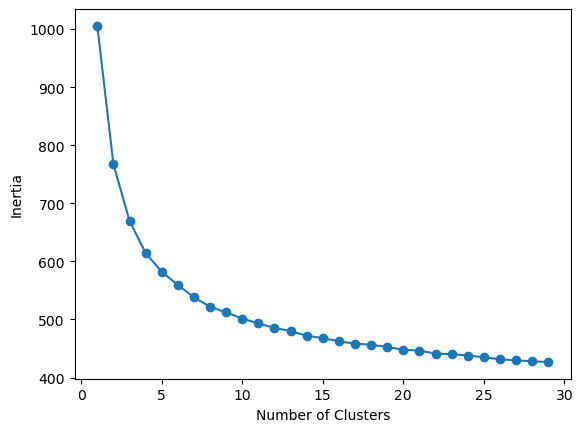

In [ ]:
#fig, ax = plt.subplots()
#ax.plot(num_cluster_array, inertia_array, marker='o')
#ax.set_xlabel('Number of Clusters')
#ax.set_ylabel('Inertia')#

around 10 seems like a good k-value

Batch 1 processed. Inertia: 534.71875
Batch 2 processed. Inertia: 539.1806030273438
Batch 3 processed. Inertia: 532.8731079101562
Batch 4 processed. Inertia: 530.0280151367188
Batch 5 processed. Inertia: 539.5338134765625
Batch 6 processed. Inertia: 542.2916259765625
Batch 7 processed. Inertia: 545.8146362304688
Batch 8 processed. Inertia: 540.3887329101562
Batch 9 processed. Inertia: 539.009765625
Batch 10 processed. Inertia: 534.1497192382812
Batch 11 processed. Inertia: 546.5305786132812
Batch 12 processed. Inertia: 559.2227783203125
Batch 13 processed. Inertia: 537.90234375
Batch 14 processed. Inertia: 545.72265625
Batch 15 processed. Inertia: 529.5518798828125
Batch 16 processed. Inertia: 554.576904296875
Batch 17 processed. Inertia: 546.1456298828125
Batch 18 processed. Inertia: 534.913330078125
Batch 19 processed. Inertia: 547.1385498046875
Batch 20 processed. Inertia: 552.9800415039062
Batch 21 processed. Inertia: 530.0055541992188
Batch 22 processed. Inertia: 524.20556640625
B

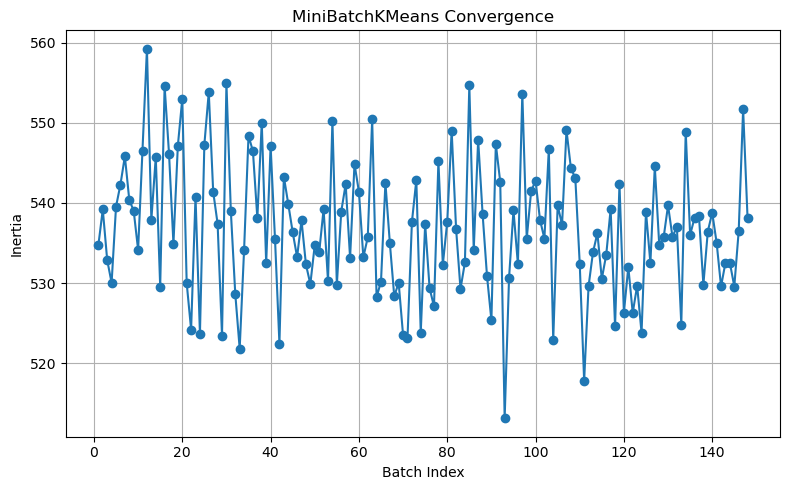

Cluster model saved at: /hpc/aklicka/Python-data/training-set-1/June_25/cluster_model/unet_June_25_kmeans.pkl


In [ ]:
#num_clusters = 10
#
#cluster_model, convergence_history = m.train_kmeans(
#    latent_features_dataset,                # tf.data.Dataset containing batches of latent feature vectors.
#    batch_size=cluster_batch_size,          # Size of each batch for the KMeans model (controls memory usage and stability).
#    num_clusters=num_clusters,              # Desired number of clusters (centroids) to form in the data.
#    max_iter=5000000,                      # Maximum iterations allowed for each mini-batch to refine centroids.
#    reassignment_ratio=0.01   # Fraction of clusters reassigned per step; lower values stabilize updates.
#)
## Save and plot convergence history
#m.plot_kmeans_convergence(convergence_history, cluster_model_path, model_name=cluster_model_name)
#
## Save cluster model
#m.save_cluster_model(cluster_model, cluster_model_path, model_name=cluster_model_name)#

### Process Matrix format data to windows for making predictions 

In [13]:
dp.delete_data_folders(
    job_data_path, 
    subdirectories=['windows/predict','windows-jpg/predict','jpg/predict'],
    override=True)

Deleted: /hpc/aklicka/Python-data/training-set-1/June_25/windows/predict
All specified folders have been successfully deleted.


In [14]:
# Prediction data in MTRX format
mtrx_predict_file_list, _ = dp.list_files_by_extension(mtrx_predict_path,'Z_mtrx',verbose=False)

dp.process_mtrx_files(
    mtrx_predict_file_list,
    job_data_path, # save data path
    flatten_method = flatten_method, pixel_density = pixel_density, pixel_ratio = pixel_ratio,
    data_scaling = data_scaling, window_size = window_size, 
    window_pitch = predict_window_pitch,
    save_windows = save_windows,
    save_window_jpgs=save_window_jpgs,
    save_jpg = save_jpg,
    together = together,
    collate = collate,
    verbose = verbose
)

Found 17 files with extension 'Z_mtrx' in directory:
/hpc/aklicka/Python-data/training-set-1/mtrx/predict
There are 17 files to process
........ttttttttt
********************
Conversion complete.
********************



### Make predictions using the trained autoencoder and KMEANS models

In [7]:
# Load the trained autoencoder
autoencoder_model = m.load_model(model_path, model_name=model_name)

# Load a previously saved cluster model from disk
cluster_model = m.load_cluster_model(cluster_model_path, model_name=cluster_model_name)

Model loaded from: /hpc/aklicka/Python-data/training-set-1/June_25/model/unet_June_25.keras
Cluster model loaded from: /hpc/aklicka/Python-data/training-set-1/June_25/cluster_model/unet_June_25_kmeans.pkl


In [8]:
# Get the list of image windows files to make predictions on
predict_data_files_list, predict_data_files_num = dp.list_files_by_extension(windows_predict_path,'.npy',verbose=False)
# Get the corresponding image coordimages list file
image_windows_coordinates_file_list , _ = dp.list_files_by_extension(windows_predict_path,'.txt',verbose=False)
image_windows_coordinates_file_list = [
    name for name in image_windows_coordinates_file_list 
    if "coordinates" in name
]

Found 32 files with extension '.npy' in directory:
/hpc/aklicka/Python-data/training-set-1/June_25/windows/predict
Found 64 files with extension '.txt' in directory:
/hpc/aklicka/Python-data/training-set-1/June_25/windows/predict


In [9]:
ut.summarize_parameters(['job_name', 'flatten_method', 'pixel_density', 'pixel_ratio', 'data_scaling', 'window_size', 
                      'window_pitch', 'model_name', 'model_train_time', 'batch_size', 'buffer_size', 'learning_rate', 
                      'epochs', 'cluster_model_name', 'cluster_batch_size', 'cluster_buffer_size', 'num_clusters', 
                      'max_iter', 'reassignment_ratio', 'predict_window_pitch', 'mtrx_train_data_limit', 
                      'mtrx_test_data_limit', 'train_data_limit', 'test_data_limit',], save_path=predictions_path)


Saved parameter summary to /hpc/aklicka/Python-data/training-set-1/June_25/predictions/parameter_summary_20250605_104301.csv


,Parameter,Value
0,job_name,June_25
1,flatten_method,poly_xy
2,pixel_density,15.0
3,pixel_ratio,0.7
4,data_scaling,1000000000.0
5,window_size,32
6,window_pitch,8
7,model_name,unet_June_25
8,model_train_time,undefined
9,batch_size,128


In [10]:

# Make predictions on the image windows and save the latent features to disk
for prediction_file, coords_file in zip(predict_data_files_list,image_windows_coordinates_file_list):
    # Load the windows for the image as a numpy file
    image_windows = np.load(prediction_file)
    # Load the image window coordinates
    image_windows_coordinates = dp.load_coordinates_file(coords_file)
    # Reconstruct the original image from the loaded image windows
    reconstructed_img = dp.reconstruct_image(image_windows,image_windows_coordinates,window_size)
    
    # Make a tensorflow data pipeline of just the image windows for this image.
    num_windows = image_windows.shape[0]
    print('\n---\nProcessing file {}'.format(os.path.basename(prediction_file)))
   
    # Predictions windows
    predict_dataset = m.create_tf_dataset_batched(
        [prediction_file], 
        batch_size=predictions_batch_size, 
        window_size=window_size,
        is_autoencoder=False, 
        shuffle=False)
   
    # make the latent features for each window using the autoencoder model 
    latent_predict_features, num_latent_predictions = m.extract_latent_features_to_disk_from_prebatched_windows(
        autoencoder_model, 
        predict_dataset, 
        '',                 # we are not saving these predictions to disk so don't need a folder or name
        features_name='',
        return_array=True,
        verbose=False)
    
    # make preductions 
    cluster_predictions = cluster_model.predict(latent_predict_features)
    
    # Build the reconstruction of the predicted cluster label data
    cluster_img = dp.reconstruct_cluster_image(image_windows_coordinates,window_size, cluster_predictions)
    
    # Pad the cluster image to the original image size
    cluster_img = ut.padded_cluster_img = ut.pad_cluster_image(reconstructed_img,cluster_img,window_size)
    image_name = os.path.splitext(os.path.basename(prediction_file))[0]
  
  #  label_stats, background_labels = m.analyse_cluster_labels(cluster_img, large_region_thresh=0.005)
  #  cluster_img = m.relabel_background(cluster_img, background_labels)

    # Save the cluster image to disk
    m.display_reconstructed_and_cluster_images(reconstructed_img,cluster_img,
                                                show_overlay=True,
                                                save_to_disk=True,
                                                output_path=predictions_path,
                                                image_name=image_name,
                                                dpi=150)  
    


---
Processing file default_2011Feb11-105510_STM-STM_Spectroscopy--110_16_BD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)


KeyboardInterrupt: 

In [42]:
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA

In [ ]:
#print('Calculating silhouette score: ', end="")
#silhouette_avg = silhouette_score(latent_predict_features, cluster_predictions)
#print(silhouette_avg)#

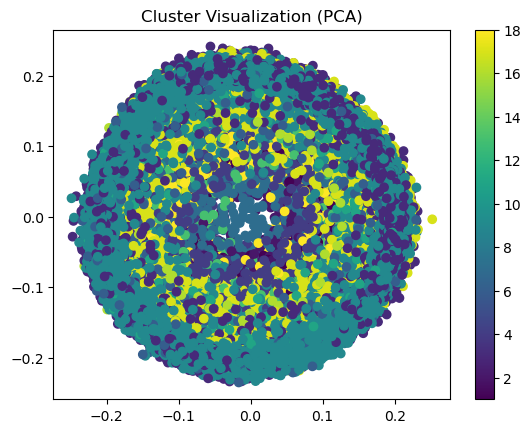

In [ ]:
   # Visualize the clusters using PCA
#pca = PCA(n_components=2)
#latent_2d = pca.fit_transform(latent_predict_features)
#plt.scatter(latent_2d[:, 0], latent_2d[:, 1], c=cluster_predictions, cmap='viridis')
#plt.colorbar()
#plt.title("Cluster Visualization (PCA)")
#plt.show()
#

/hpc/aklicka/.conda/envs/tf-adam/lib/python3.9/site-packages/matplotlib/collections.py:996: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor


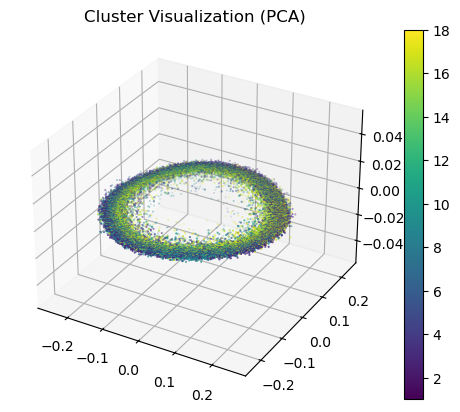

In [47]:
pca = PCA(n_components=3)
latent_3d = pca.fit_transform(latent_predict_features)

fig = plt.figure()
ax = fig.add_subplot(projection='3d')

plt.scatter(latent_3d[:, 0], latent_3d[:, 1], latent_3d[:, 2], c=cluster_predictions, cmap='viridis')
plt.colorbar()
plt.title("Cluster Visualization (PCA)")
plt.show()


## Testing t-SNE in 2D

In [48]:
from time import time
from matplotlib.ticker import NullFormatter
from sklearn import datasets, manifold

In [58]:
n_components = 2
perplexity = 50

t0 = time()
tsne = manifold.TSNE(
    n_components=n_components,
    init="random",
    random_state=0,
    perplexity=perplexity,
    max_iter=300,
)
Y = tsne.fit_transform(latent_predict_features)
t1 = time()
print("circles, perplexity=%d in %.2g sec" % (perplexity, t1 - t0))


circles, perplexity=50 in 4.3e+02 sec


(-12.527490854263306,
 12.260720491409302,
 -12.202677345275879,
 12.731735801696777)

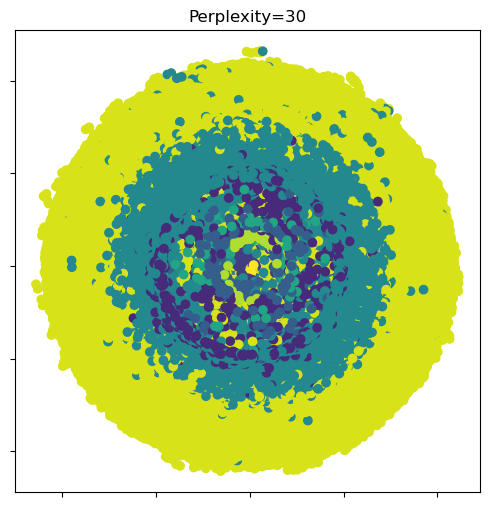

In [ ]:
fig, ax = plt.subplots(figsize=(6, 6))
ax.set_title("t-SNE: Perplexity=%d" % perplexity)
ax.scatter(Y[:, 0], Y[:, 1], c=cluster_predictions, cmap='viridis')
#ax.scatter(Y[green, 0], Y[green, 1], c="g")
ax.xaxis.set_major_formatter(NullFormatter())
ax.yaxis.set_major_formatter(NullFormatter())
ax.axis("tight")

(-12.016918992996215,
 12.026758050918579,
 -12.100544738769532,
 12.227736282348634)

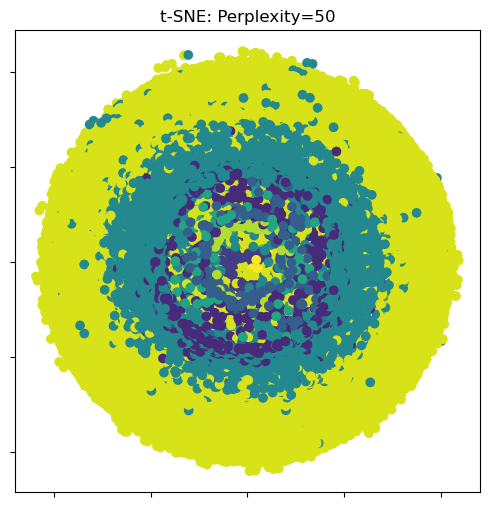

In [59]:
fig, ax = plt.subplots(figsize=(6, 6))
ax.set_title("t-SNE: Perplexity=%d" % perplexity)
ax.scatter(Y[:, 0], Y[:, 1], c=cluster_predictions, cmap='viridis')
#ax.scatter(Y[green, 0], Y[green, 1], c="g")
ax.xaxis.set_major_formatter(NullFormatter())
ax.yaxis.set_major_formatter(NullFormatter())
ax.axis("tight")

In [53]:
print(Y.shape)


(129600, 2)


## Testing t-SNE in 3D

In [60]:
n_components = 3 # Dimensions for t-SNE
perplexity = 50

t0 = time()
tsne = manifold.TSNE(
    n_components=n_components,
    init="random",
    random_state=0,
    perplexity=perplexity,
    max_iter=300,
)
Y3D = tsne.fit_transform(latent_predict_features)
t1 = time()
print("circles, perplexity=%d in %.2g sec" % (perplexity, t1 - t0))

circles, perplexity=50 in 6.5e+02 sec


(-8.36364342768987,
 8.418128748734793,
 -8.401583805680275,
 8.167792931199074,
 -7.631767873962721,
 7.164301042755445)

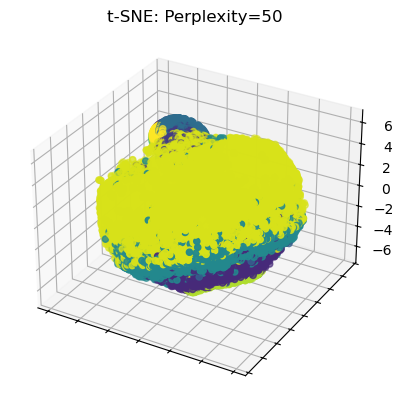

In [61]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.set_title("t-SNE: Perplexity=%d" % perplexity)
ax.scatter(Y3D[:, 0], Y3D[:, 1], Y3D[:, 2], c=cluster_predictions, cmap='viridis')
#ax.scatter(Y[green, 0], Y[green, 1], c="g")
ax.xaxis.set_major_formatter(NullFormatter())
ax.yaxis.set_major_formatter(NullFormatter())
ax.axis("tight")

In [11]:
import skimage as ski
from skimage import morphology, measure

In [25]:
prediction_file = predict_data_files_list[8]  # Use the first prediction file for demonstration
coords_file = image_windows_coordinates_file_list[8]  # Use the corresponding coordinates file
print(prediction_file)

# Load the windows for the image as a numpy file
image_windows = np.load(prediction_file)
# Load the image window coordinates
image_windows_coordinates = dp.load_coordinates_file(coords_file)
# Reconstruct the original image from the loaded image windows
reconstructed_img = dp.reconstruct_image(image_windows,image_windows_coordinates,window_size)

# Make a tensorflow data pipeline of just the image windows for this image.
num_windows = image_windows.shape[0]
print('\n---\nProcessing file {}'.format(os.path.basename(prediction_file)))

# Predictions windows
predict_dataset = m.create_tf_dataset_batched(
    [prediction_file], 
    batch_size=predictions_batch_size, 
    window_size=window_size,
    is_autoencoder=False, 
    shuffle=False)

# make the latent features for each window using the autoencoder model 
latent_predict_features, num_latent_predictions = m.extract_latent_features_to_disk_from_prebatched_windows(
    autoencoder_model, 
    predict_dataset, 
    '',                 # we are not saving these predictions to disk so don't need a folder or name
    features_name='',
    return_array=True,
    verbose=False)

# make preductions 
cluster_predictions = cluster_model.predict(latent_predict_features)

# Build the reconstruction of the predicted cluster label data
cluster_img = dp.reconstruct_cluster_image(image_windows_coordinates,window_size, cluster_predictions)

# Pad the cluster image to the original image size
cluster_img = ut.padded_cluster_img = ut.pad_cluster_image(reconstructed_img,cluster_img,window_size)
image_name = os.path.splitext(os.path.basename(prediction_file))[0]


/hpc/aklicka/Python-data/training-set-1/June_25/windows/predict/default_2011Mar17-102654_STM-STM_Spectroscopy--1_2_BU/default_2011Mar17-102654_STM-STM_Spectroscopy--1_2_BU_all_windows.npy

---
Processing file default_2011Mar17-102654_STM-STM_Spectroscopy--1_2_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
...Combined latent features shape: (72390, 4096)


In [29]:
def reconstruct_predict(prediction_file, coords_file, autoencoder_model, cluster_model, window_size, predictions_batch_size):
    """
    Reconstructs an image and its cluster predictions from a prediction file and coordinates file.
    
    Returns: reconstructed_img, cluster_img
    """
    # Load the windows for the image as a numpy file
    image_windows = np.load(prediction_file)
    # Load the image window coordinates
    image_windows_coordinates = dp.load_coordinates_file(coords_file)
    # Reconstruct the original image from the loaded image windows
    reconstructed_img = dp.reconstruct_image(image_windows,image_windows_coordinates,window_size)

    # Make a tensorflow data pipeline of just the image windows for this image.
    num_windows = image_windows.shape[0]
    print('\n---\nProcessing file {}'.format(os.path.basename(prediction_file)))

    # Predictions windows
    predict_dataset = m.create_tf_dataset_batched(
        [prediction_file], 
        batch_size=predictions_batch_size, 
        window_size=window_size,
        is_autoencoder=False, 
        shuffle=False)

    # make the latent features for each window using the autoencoder model 
    latent_predict_features, num_latent_predictions = m.extract_latent_features_to_disk_from_prebatched_windows(
        autoencoder_model, 
        predict_dataset, 
        '',                 # we are not saving these predictions to disk so don't need a folder or name
        features_name='',
        return_array=True,
        verbose=False)

    # make preductions 
    cluster_predictions = cluster_model.predict(latent_predict_features)

    # Build the reconstruction of the predicted cluster label data
    cluster_img = dp.reconstruct_cluster_image(image_windows_coordinates,window_size, cluster_predictions)

    # Pad the cluster image to the original image size
    cluster_img = ut.padded_cluster_img = ut.pad_cluster_image(reconstructed_img,cluster_img,window_size)
    
    return reconstructed_img, cluster_img

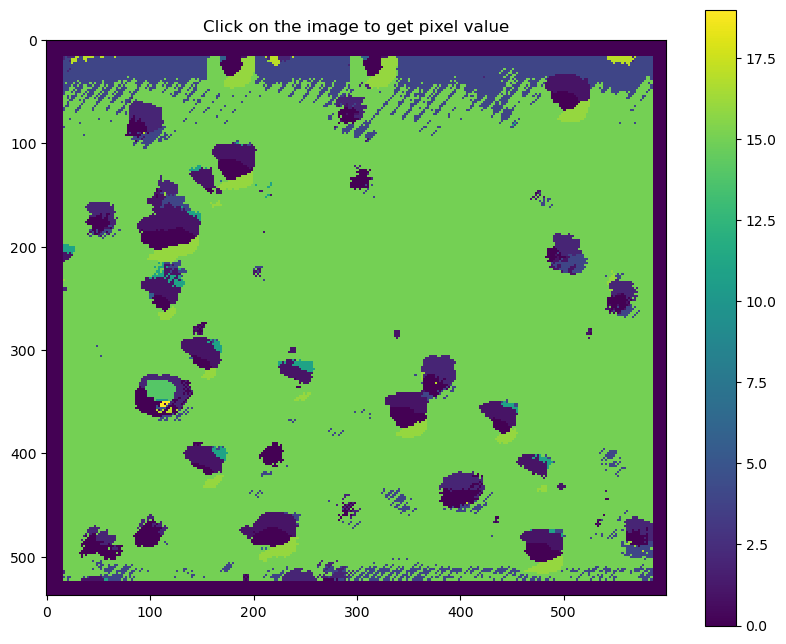

In [26]:
data = cluster_img
# Function to display pixel values on click
def on_click(event):
    # Check if the click is on the image
    if event.inaxes:
        # Get the row and column indices
        col, row = int(event.xdata + 0.5), int(event.ydata + 0.5)
        # Get the pixel value
        pixel_value = data[row, col]
        print(f"Clicked on ({row}, {col}) with value: {pixel_value}")
# Plot the image
fig, ax = plt.subplots(figsize=(10, 8))  # Adjust figsize (width, height) as desired
cax = ax.imshow(data, cmap='viridis', interpolation='nearest')
fig.colorbar(cax, ax=ax)
ax.set_title("Click on the image to get pixel value")
# Connect the click event to the function
cid = fig.canvas.mpl_connect('button_press_event', on_click)
# Show the plot
plt.show()

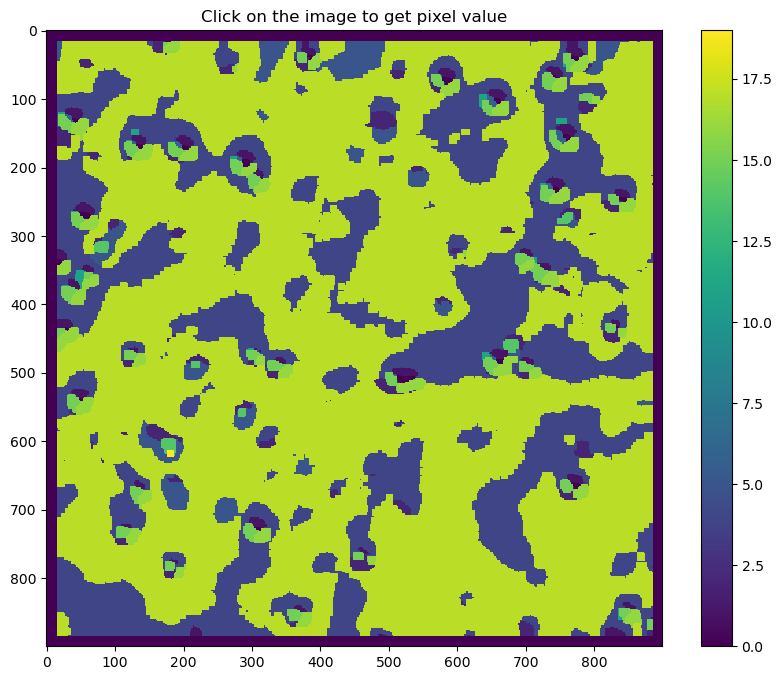

In [20]:

#
#
##data processing
##b = morphology.remove_small_objects(data_postprocess, min_size=100)
#footprint = ski.morphology.disk(1)
#b = morphology.opening(data_postprocess, footprint=[(np.ones((9,1)),1), (np.ones((1,9)),1)])  # Apply closing operation to fill small holes
##footprint2 = morphology.footprint_rectangle((3, 3))  # Create a rectangular footprint of size 3x3
##eroded = ski.morphology.erosion(data_postprocess, footprint=footprint)
#
##foreground = ski.morphology.remove_small_objects(data_postprocess, min_size=10)
#objects = ski.measure.label(foreground)
#
#
## Plot the image
#fig, ax = plt.subplots(figsize=(10, 8))  # Adjust figsize (width, height) as desired
#cax = ax.imshow(b, cmap='viridis', interpolation='nearest')
#fig.colorbar(cax, ax=ax)
#ax.set_title("Click on the image to get pixel value")
## Connect the click event to the function
#cid = fig.canvas.mpl_connect('button_press_event', on_click)
## Show the plot
#plt.show()#

In [ ]:
bins = np.bincount()

In [14]:
def remove_small_objects(ar, min_size=7,out=None):
    """
    Remove small objects from a binary array.
    
    Parameters:
    - ar: Input binary array.
    - min_size: Minimum size of objects to keep.
    
    
    Returns:
    - Binary array with small objects removed.
    """
    if out is None:
        out = ar.copy()
    else:
        out[:] = ar
    ccs = out
    component_sizes = np.bincount(ccs.ravel())
    too_small = component_sizes < min_size
    too_small_mask = too_small[ccs]
    out[too_small_mask] = 0
    
    
    return out

def remove_large_objects(ar, max_size=5000, out=None):
    """
    Remove large objects from a binary array.
    
    Parameters:
    - ar: Input binary array.
    - max_size: Maximum size of objects to keep.
    
    
    Returns:
    - Binary array with large objects removed.
    """
    if out is None:
        out = ar.copy()
    else:
        out[:] = ar
    ccs = out
    component_sizes = np.bincount(ccs.ravel())
    too_large = component_sizes > max_size
    too_large_mask = too_large[ccs]
    out[too_large_mask] = 0
    
    return out

In [33]:
n, m = cluster_img.shape
print(n, m)
print(15000/(900**2))

900 900
0.018518518518518517


In [35]:
data = cluster_img.astype("int32")
print(np.bincount(data.ravel()))

[ 54592   7856   9768    112 169872  15052    652      0      0      0
      0   4856      0      0   1800  12212  16324 516636      0    268]


In [59]:
import scipy 


def detect_features_find_centres(cluster_img, max_size=20000, area_threshold=10,):
    data_postprocess = cluster_img.astype("int")  # Convert to boolean type for morphological operations

    #remove background
    large_removed = remove_large_objects(data_postprocess, max_size=max_size)
    #small_removed = remove_small_objects(large_removed, min_size=1000)  # Remove small objects with a minimum size of 100 pixels


    area_closed = morphology.area_closing(large_removed, area_threshold=area_threshold)  # Apply closing operation to fill small holes
    area_opened = morphology.area_opening(area_closed, area_threshold=area_threshold)  # Apply opening operation to remove small objects
    #eroded = morphology.erosion(area_opened, morphology.disk(4))  # Apply opening operation to remove small objects


    foreground = area_opened > 0  # Convert to boolean type for morphological operations
    #Perform connected component labeling
    #labeled_array, num_features = ski.measure.label(foreground, return_num=True, connectivity=2)  # Use connectivity=2 for 8-connectivity

    labeled_array, num_features = scipy.ndimage.label(foreground)  # Use a 3x3 structure for connectivity

    #connect_labels = ski.measure.label(labeled_array, connectivity=2)  # Use connectivity=2 for 8-connectivity
    centers = scipy.ndimage.center_of_mass(foreground, labeled_array, range(1, num_features + 1))
    centers = np.array(centers)  # Convert to numpy array for easier manipulation

    #centers = [list(region.centroid) for region in regions]
    #centers = np.array(centers)  # Transpose to get x and y coordinates

    #features = large_removed
    features = labeled_array
    return features, centers, labeled_array, num_features

In [55]:
def display_reconstructed_and_cluster_images_and_extracted_features(reconstructed_img, cluster_img, features_img, centers, 
                                             save_to_disk=False, output_path=None, image_name='img', dpi=150):
    """
    Display side-by-side images: the reconstructed input image, the cluster labels,
    and the highlighted features.

    Parameters:
    - reconstructed_img (ndarray): The reconstructed image, typically the output
      from an autoencoder or similar model.
    - cluster_img (ndarray): The image showing cluster labels, usually resulting
      from clustering analysis on the latent space.
    - features_img (ndarray): The image showing highlighted features, such as
      detected regions or points of interest.
    - centers (list): List of coordinates for the centers of detected features.
    #- show_overlay (bool): Optional; if True, displays a third panel with an overlay
    #  of the reconstructed image and cluster labels. Default is True.
    - save_to_disk (bool): Optional; if True, saves the image to disk instead of displaying it. Default is False.
    - output_path (str): The path to save the image if save_to_disk is True. Required if save_to_disk is True.
    - dpi (int): Optional; the resolution in dots per inch for saving the image. Default is 300.

    Returns:
    - None: This function either displays the plot or saves it to disk based on save_to_disk.
    """
    # Output directory with timestamp
    if save_to_disk:
      if not os.path.exists(output_path):
        os.makedirs(output_path)
        print(f"Directory created: {output_path}")
        
    n_plots = 3  # Number of plots to display
    fig, ax = plt.subplots(1, n_plots, figsize=(6 * n_plots, 6))
    
    # Plot the first image (Reconstructed Image)
    ax[0].imshow(reconstructed_img, cmap='viridis')
    ax[0].set_title('Input Image')
    ax[0].axis('off')  # Remove axis labels

    # Plot the second image (Cluster Labels)
    ax[1].imshow(cluster_img, cmap='viridis', interpolation='nearest')
    ax[1].set_title('Cluster Labels')
    ax[1].axis('off')  # Remove axis labels
    
    ax[2].imshow(features_img, cmap='viridis', interpolation='nearest')
    
    ax[2].set_title('Detected Features')
    ax[2].axis('off')  # Remove axis labels
    
    if len(centers) > 0:
      ax[0].scatter(centers[:, 1], centers[:, 0], color='red', s=5)  # Highlight the centers of detected features
      ax[1].scatter(centers[:, 1], centers[:, 0], color='red', s=5)  # Highlight the centers of detected features
      ax[2].scatter(centers[:, 1], centers[:, 0], color='red', s=5)  # Highlight the centers of detected features
        
    plt.tight_layout()
    
    # Save to disk or display
    if save_to_disk:
        if output_path:
            output_path = os.path.join(output_path, f"{image_name}.jpg")
            plt.savefig(output_path, format='jpg', dpi=dpi)
            print(f"Image saved to {output_path} with dpi={dpi}")
        else:
            print("Error: output_path must be specified when save_to_disk is True.")
    else:
        plt.show()

    # Close the figure to release memory
    plt.close(fig)


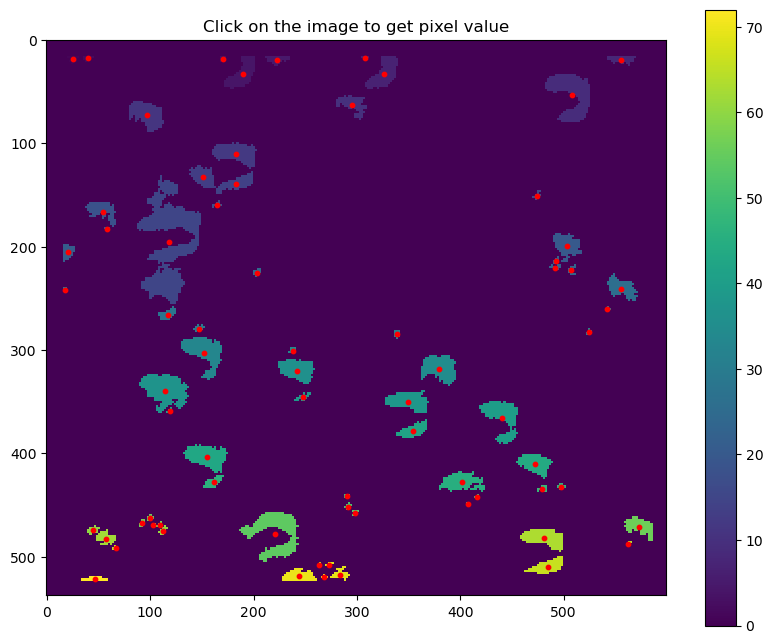

In [30]:
import scipy

data_postprocess = cluster_img.astype("int")  # Convert to boolean type for morphological operations


large_removed = remove_large_objects(data_postprocess, max_size=20000)
#small_removed = remove_small_objects(large_removed, min_size=1000)  # Remove small objects with a minimum size of 100 pixels
#print(np.bincount(large_removed.ravel()))

area_closed = morphology.area_closing(large_removed, area_threshold=10)  # Apply closing operation to fill small holes
area_opened = morphology.area_opening(area_closed, area_threshold=10)  # Apply opening operation to remove small objects
#eroded = morphology.erosion(area_opened, morphology.disk(4))  # Apply opening operation to remove small objects


foreground = area_opened > 0  # Convert to boolean type for morphological operations
#Perform connected component labeling
#labeled_array, num_features = ski.measure.label(foreground, return_num=True, connectivity=2)  # Use connectivity=2 for 8-connectivity

labeled_array, num_features = scipy.ndimage.label(foreground)  # Use a 3x3 structure for connectivity

#connect_labels = ski.measure.label(labeled_array, connectivity=2)  # Use connectivity=2 for 8-connectivity
centers = scipy.ndimage.center_of_mass(foreground, labeled_array, range(1, num_features + 1))
centers = np.array(centers)  # Convert to numpy array for easier manipulation

#centers = [list(region.centroid) for region in regions]
#centers = np.array(centers)  # Transpose to get x and y coordinates

out = large_removed

# Plot the image
fig, ax = plt.subplots(figsize=(10, 8))  # Adjust figsize (width, height) as desired
cax = ax.imshow(labeled_array, cmap='viridis', interpolation='nearest')
fig.colorbar(cax, ax=ax)
ax.set_title("Click on the image to get pixel value")
ax.scatter(centers[:,1],centers[:,0], color='red', s=10, label='Centroids')  # Plot centroids
# Connect the click event to the function
cid = fig.canvas.mpl_connect('button_press_event', on_click)
# Show the plot
plt.show()

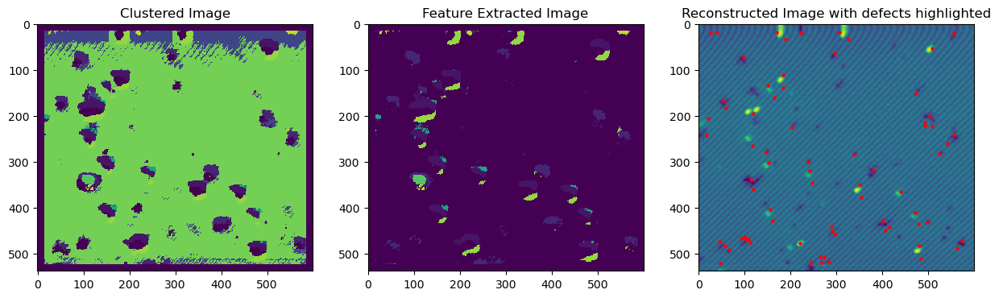

In [31]:
fig, ax = plt.subplots(1, 3, figsize=(15, 8))  # Adjust figsize (width, height) as desired

ax[0].imshow(cluster_img, cmap='viridis', interpolation='nearest')
ax[0].set_title("Clustered Image")
cax = ax[1].imshow(out, cmap='viridis', interpolation='nearest')
#fig.colorbar(cax, ax=ax[0])
ax[1].set_title("Feature Extracted Image")
# Connect the click event to the function
cid = fig.canvas.mpl_connect('button_press_event', on_click)
ax[2].set_title("Reconstructed Image with defects highlighted")
ax[2].imshow(reconstructed_img, cmap='viridis', interpolation='nearest')
ax[2].scatter(centers[:,1],centers[:,0], color='red', s=5, label='Centroids')  # Plot centroids
# Show the plot
plt.show()


---
Processing file default_2011Feb11-105510_STM-STM_Spectroscopy--110_16_FD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
......Combined latent features shape: (189225, 4096)


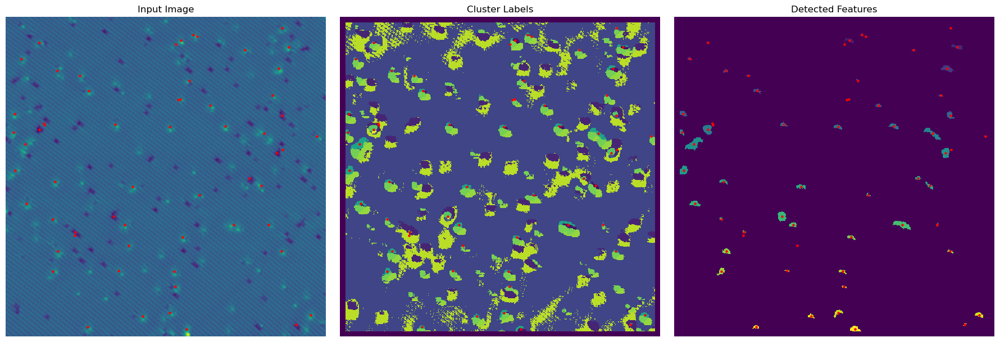

In [62]:
image_num = 2
prediction_file = predict_data_files_list[image_num]  
coords_file = image_windows_coordinates_file_list[image_num]  

#get reconstructed image and cluster image
reconstructed_img, cluster_img = reconstruct_predict(prediction_file, coords_file, autoencoder_model, cluster_model, window_size, predictions_batch_size)

# Detect features and find centers
features, centers, labeled_array, num_features = detect_features_find_centres(cluster_img, max_size=20000, area_threshold=10)
#display the images and extracted features
display_reconstructed_and_cluster_images_and_extracted_features(
    reconstructed_img, 
    cluster_img, 
    features, 
    centers, 
    save_to_disk=False,
)

In [120]:
def extract_centroid_windows(image, centers, px=128):

    
    #print('EXTRRACTING WINDOWS. ORIG IMAGE: Height {} Width {}'.format(height, width))
    height, width = image.shape


    # Extract windows and record coordinates
    windows = np.zeros((len(centers), px * 2, px * 2), dtype=image.dtype)  # Initialize windows array
    centers = np.round(centers).astype(int)  # Ensure centers are integers for indexing
    px = int(px)  # Ensure px is an integer for indexing
    for i in range(len(centers)):
        y = centers[i, 0]
        x = centers[i, 1]
            
        # Adjust start positions to ensure full windows at the edges
        if y + px > height:
            y = height - px
        if x + px > width:
            x = width - px
        if y - px < 0:
            y = px
        if x - px < 0:
            x = px

        # Extract windows with consistent size
        window = image[y-px:y+px, x-px:x+px]
        windows[i, :, :] = window

        # if window.shape[0] != 32 or window.shape[1] != 32:
        #     print('\n\n*************\n window number {}: {} {}\n\n'.format(window_number, window.shape[0],window.shape[1]))
            
        #     plt.imshow(window)
        #     plt.show()

    return np.array(windows), centers


In [109]:
print(reconstructed_img.shape)

print(len(centers))

(900, 900)
60


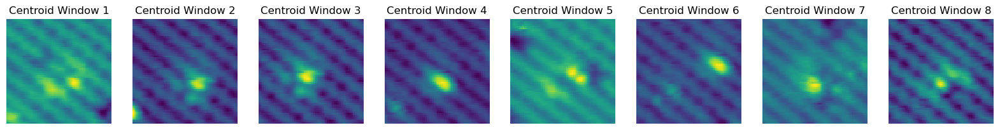

In [123]:
centroid_windows, centers = extract_centroid_windows(reconstructed_img, centers, px=30)
fig, ax = plt.subplots(1, 8, figsize=(20, 8))  # Adjust figsize (width, height) as desired
for i in range(8):
    ax[i].imshow(centroid_windows[i], cmap='viridis', interpolation='nearest')
    ax[i].set_title(f"Centroid Window {i+1}")
    ax[i].axis('off')  # Remove axis labels

## Iterate over all prediction images and display original image, clustered image, and the selected features/defects


---
Processing file default_2011Feb11-105510_STM-STM_Spectroscopy--110_16_BD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
......Combined latent features shape: (189225, 4096)


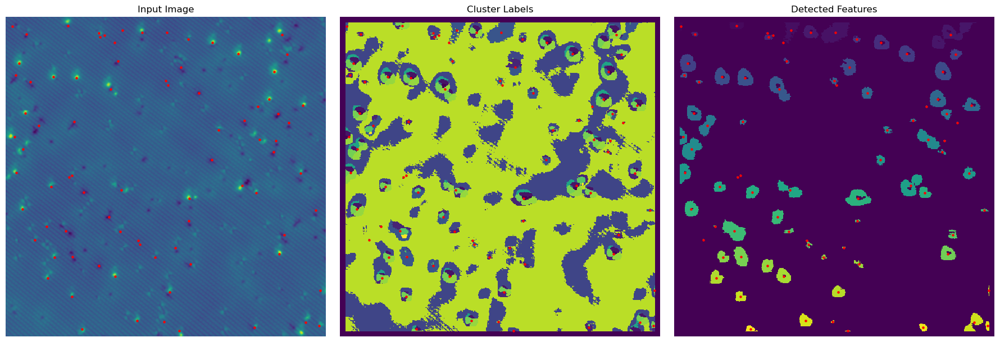


---
Processing file default_2011Feb11-105510_STM-STM_Spectroscopy--110_16_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
......Combined latent features shape: (189225, 4096)


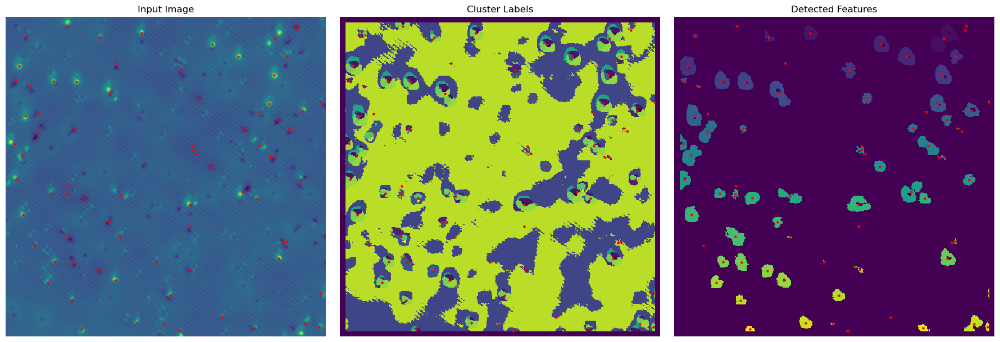


---
Processing file default_2011Feb11-105510_STM-STM_Spectroscopy--110_16_FD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
......Combined latent features shape: (189225, 4096)


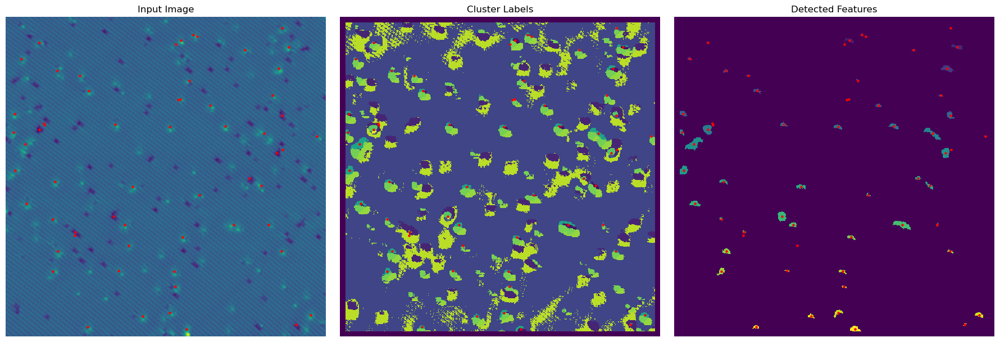


---
Processing file default_2011Feb11-105510_STM-STM_Spectroscopy--110_16_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
......Combined latent features shape: (189225, 4096)


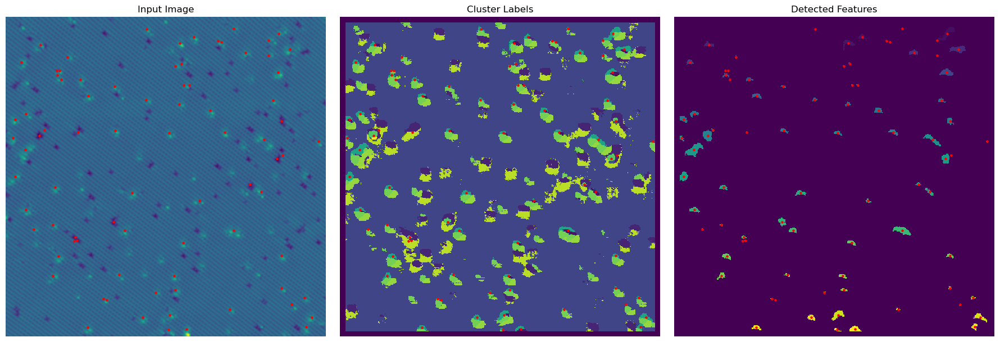


---
Processing file default_2011Mar10-162902_STM-STM_Spectroscopy--1_3_BD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (18225, 32, 32, 1)
.Combined latent features shape: (18225, 4096)


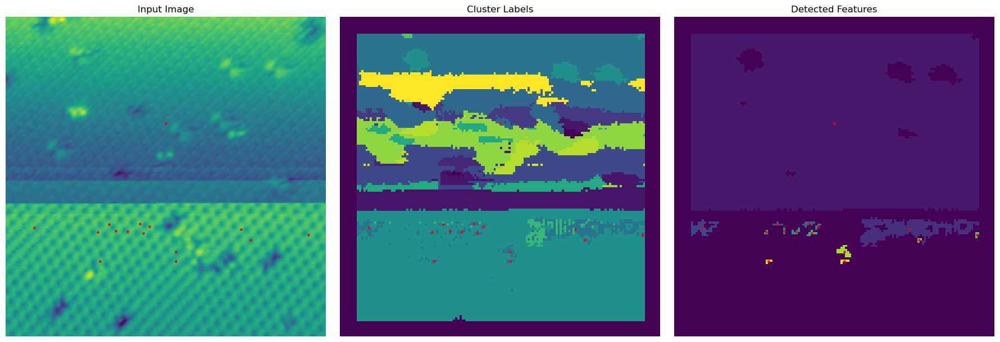


---
Processing file default_2011Mar10-162902_STM-STM_Spectroscopy--1_3_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (18225, 32, 32, 1)
.Combined latent features shape: (18225, 4096)


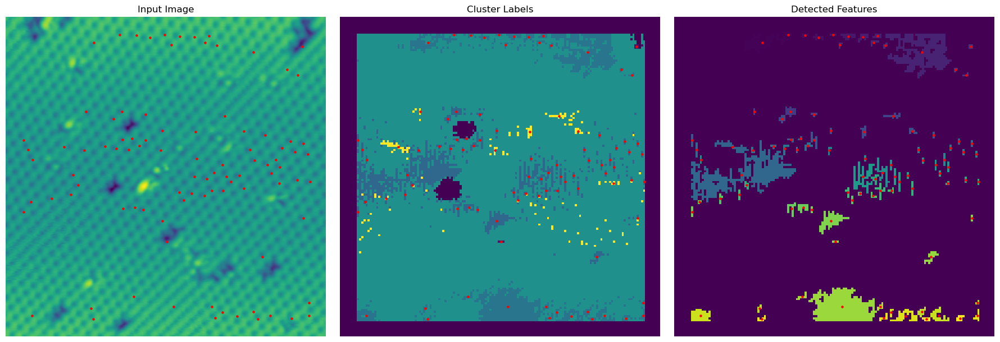


---
Processing file default_2011Mar10-162902_STM-STM_Spectroscopy--1_3_FD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (18225, 32, 32, 1)
.Combined latent features shape: (18225, 4096)


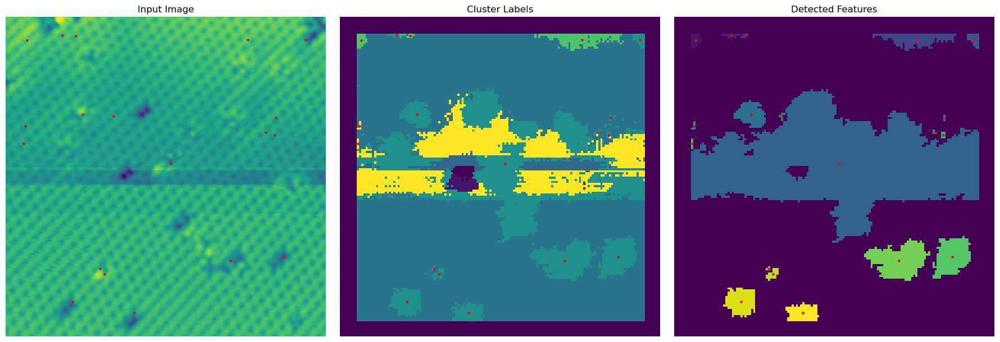


---
Processing file default_2011Mar10-162902_STM-STM_Spectroscopy--1_3_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (18225, 32, 32, 1)
.Combined latent features shape: (18225, 4096)


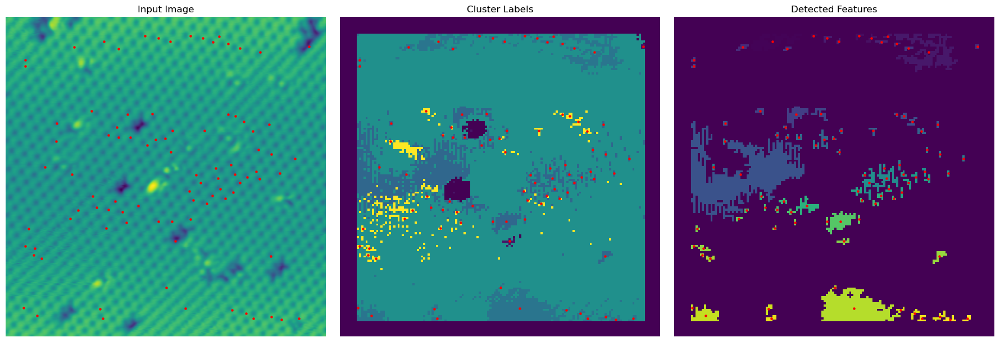


---
Processing file default_2011Mar17-102654_STM-STM_Spectroscopy--1_2_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
...Combined latent features shape: (72390, 4096)


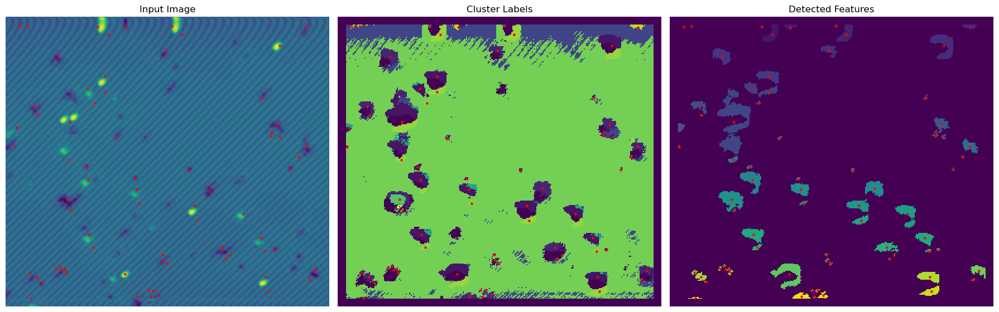


---
Processing file default_2011Mar17-102654_STM-STM_Spectroscopy--1_2_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
...Combined latent features shape: (72390, 4096)


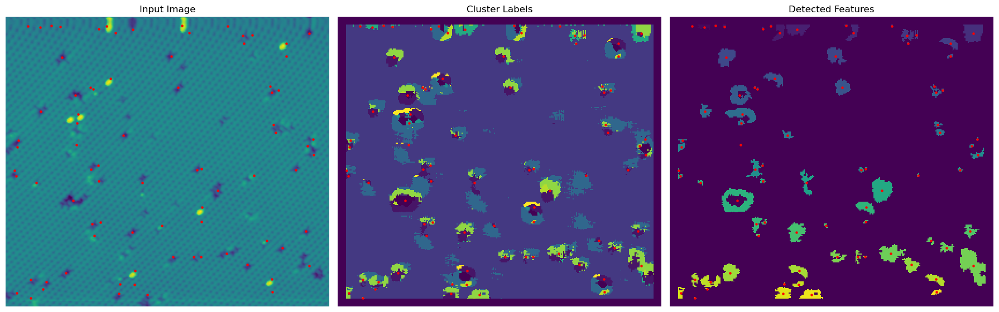


---
Processing file default_2011May27-164015_STM-STM_Spectroscopy--22_4_BD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (18225, 32, 32, 1)
.Combined latent features shape: (18225, 4096)


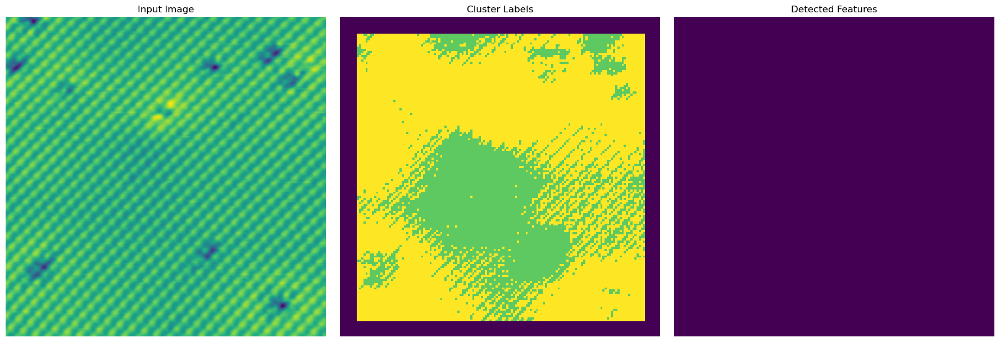


---
Processing file default_2011May27-164015_STM-STM_Spectroscopy--22_4_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (18225, 32, 32, 1)
.Combined latent features shape: (18225, 4096)


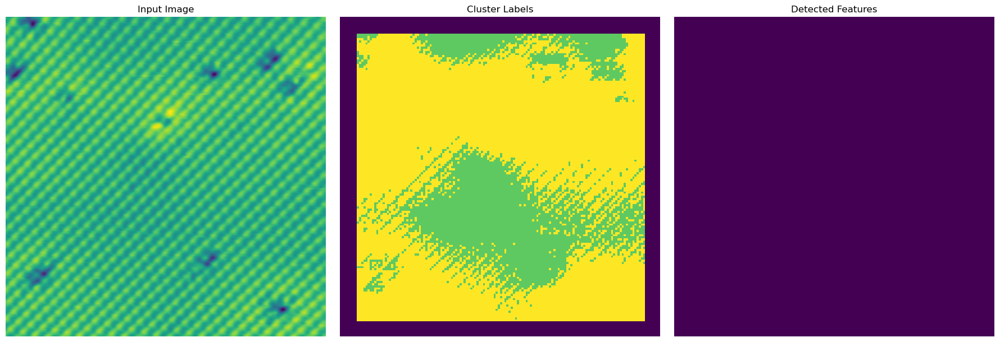


---
Processing file default_2011May27-164015_STM-STM_Spectroscopy--22_4_FD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (18225, 32, 32, 1)
.Combined latent features shape: (18225, 4096)


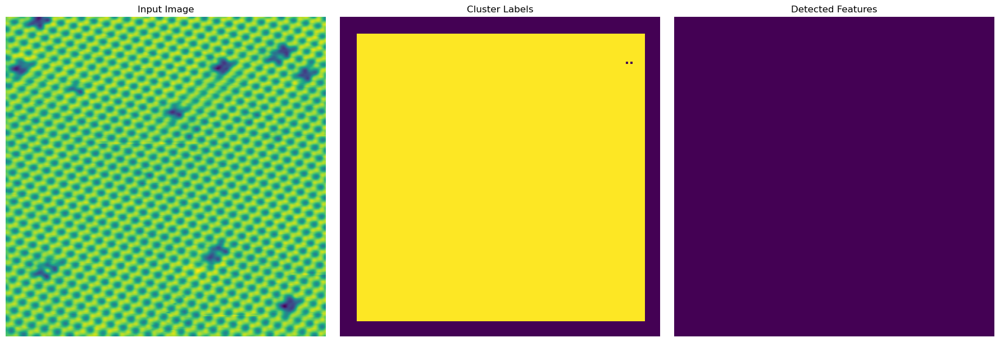


---
Processing file default_2011May27-164015_STM-STM_Spectroscopy--22_4_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (18225, 32, 32, 1)
.Combined latent features shape: (18225, 4096)


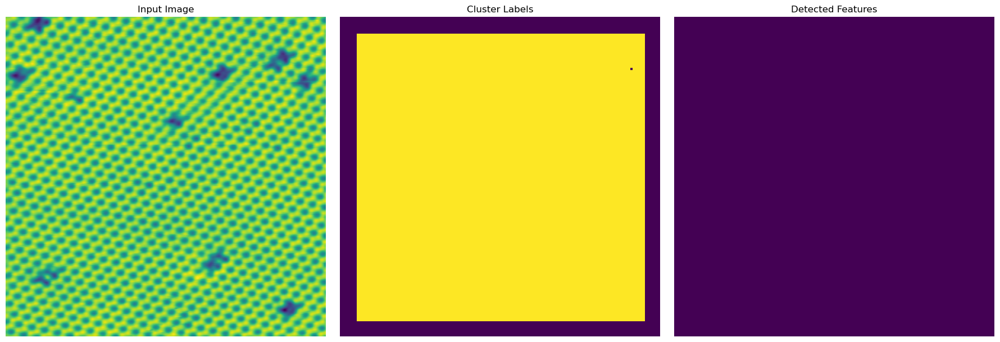


---
Processing file default_2013Mar22-133720_STM-STM_Spectroscopy--44_2_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
...Combined latent features shape: (81225, 4096)


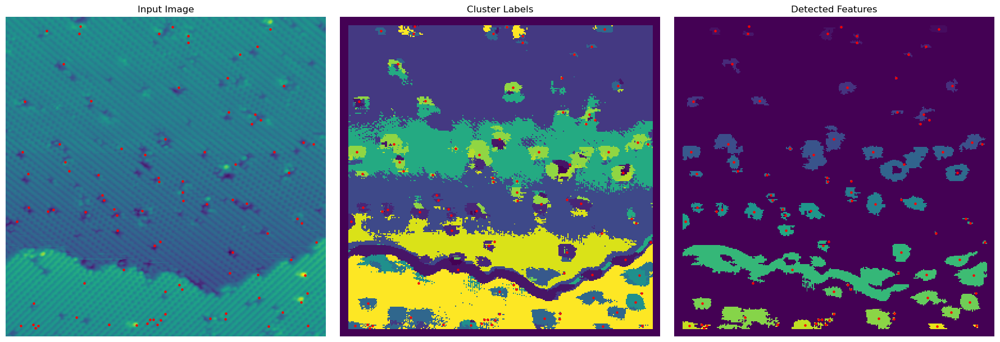


---
Processing file default_2013Mar22-133720_STM-STM_Spectroscopy--44_2_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
...Combined latent features shape: (81225, 4096)


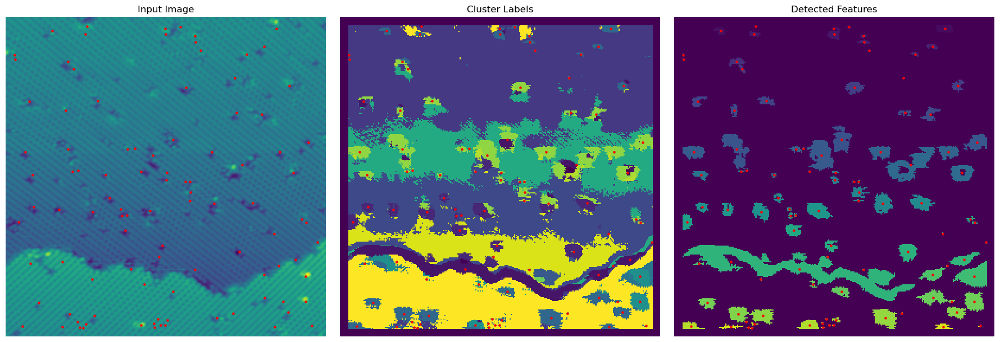


---
Processing file default_2014Aug06-115806_STM-STM_Spectroscopy--12_2_BD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
...Combined latent features shape: (81225, 4096)


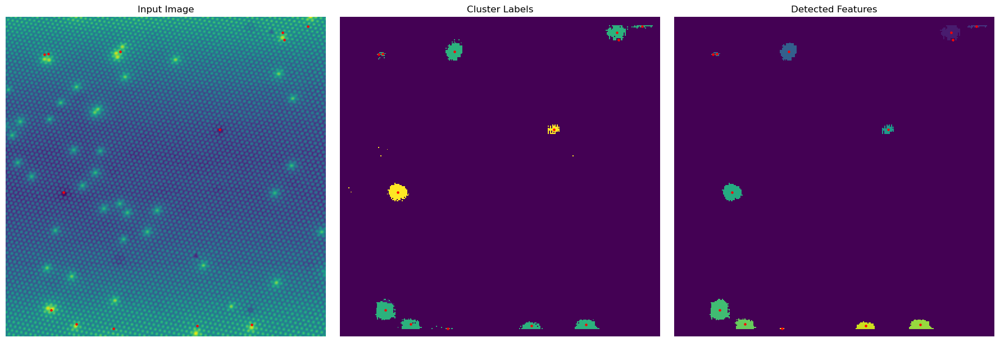


---
Processing file default_2014Aug06-115806_STM-STM_Spectroscopy--12_2_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
...Combined latent features shape: (81225, 4096)


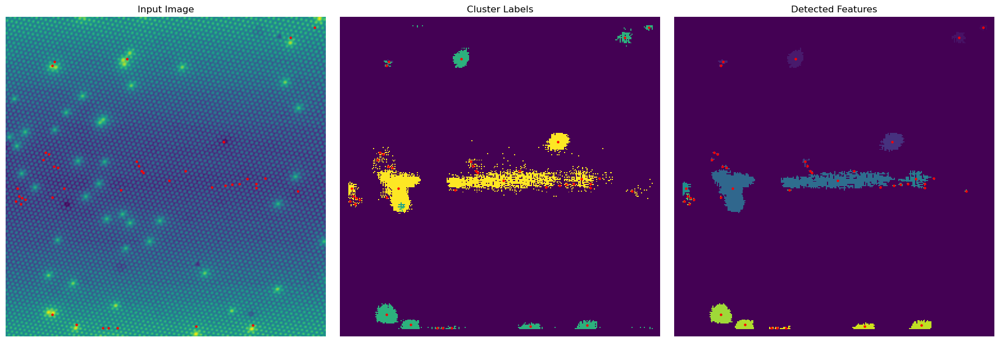


---
Processing file default_2014Aug06-115806_STM-STM_Spectroscopy--12_2_FD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
...Combined latent features shape: (81225, 4096)


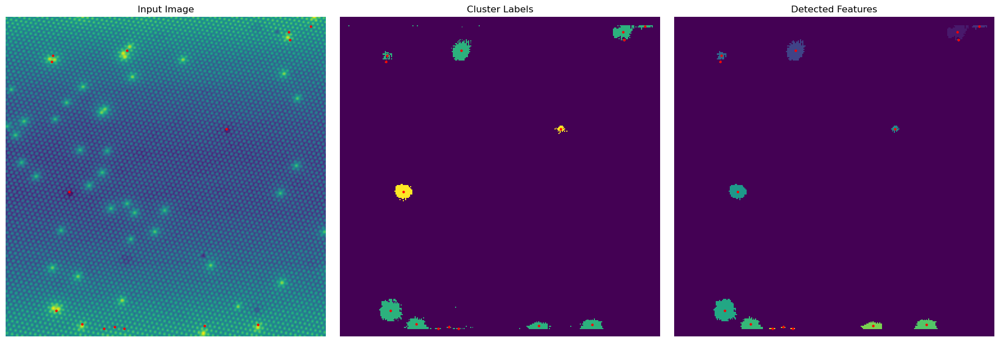


---
Processing file default_2014Aug06-115806_STM-STM_Spectroscopy--12_2_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
...Combined latent features shape: (81225, 4096)


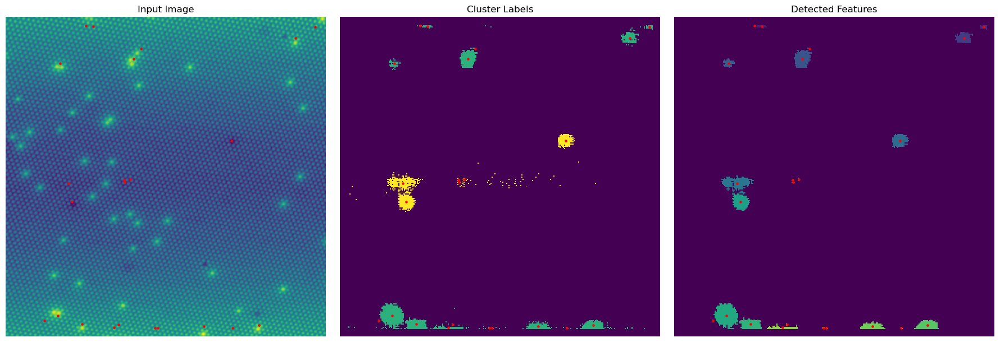


---
Processing file default_2022Jan12-130324_STM-STM_Spectroscopy--2_3_BD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


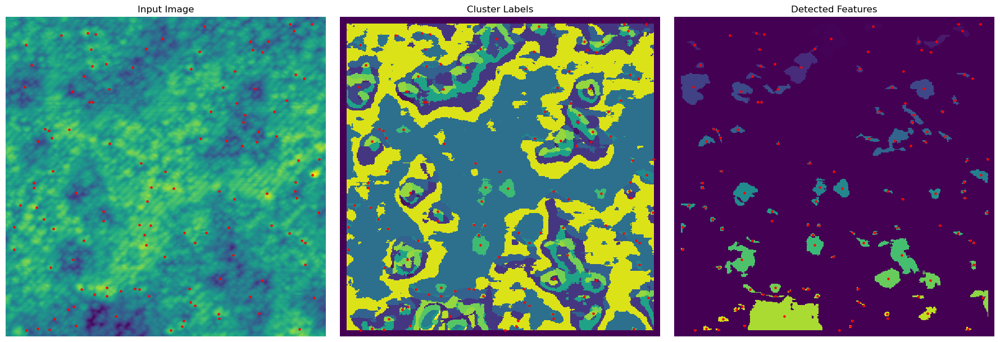


---
Processing file default_2022Jan12-130324_STM-STM_Spectroscopy--2_3_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


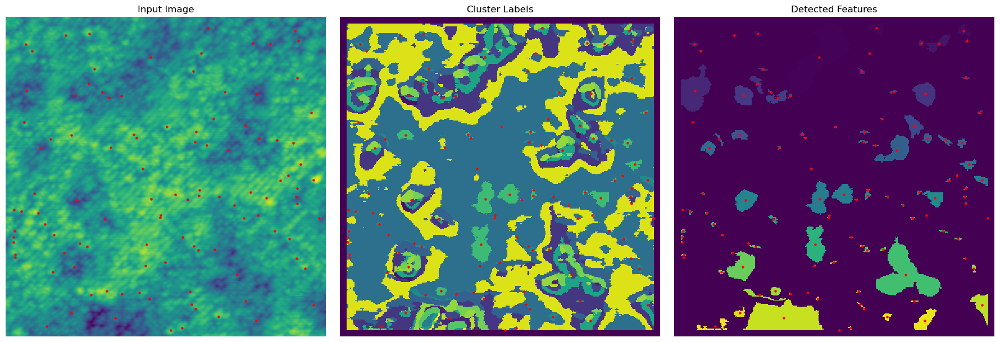


---
Processing file default_2022Jan12-130324_STM-STM_Spectroscopy--2_3_FD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


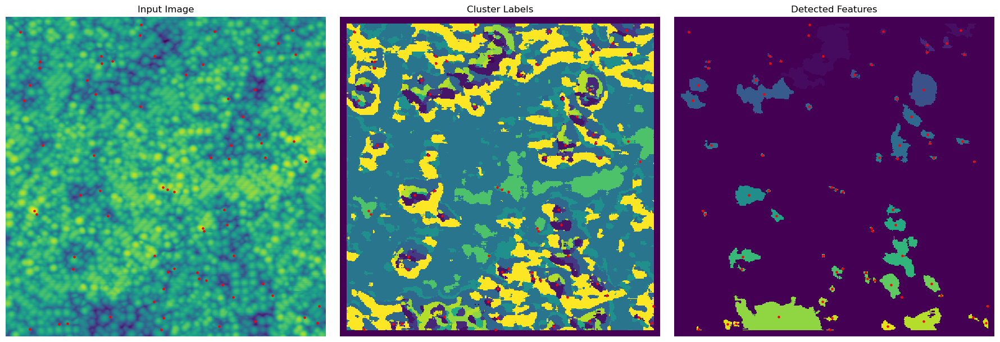


---
Processing file default_2022Jan12-130324_STM-STM_Spectroscopy--2_3_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


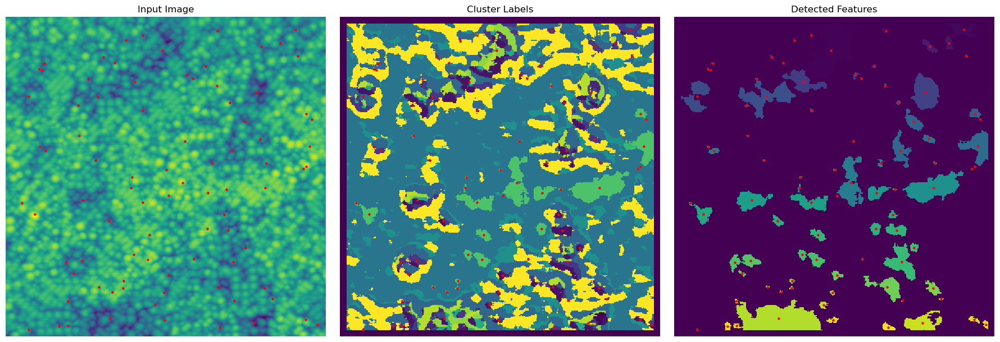


---
Processing file default_2024Aug07-153010_STM-STM_Spectroscopy--8_1_BD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


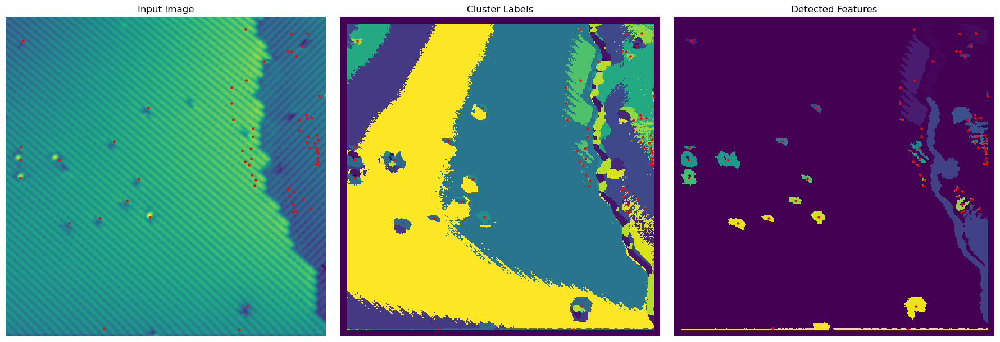


---
Processing file default_2024Aug07-153010_STM-STM_Spectroscopy--8_1_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


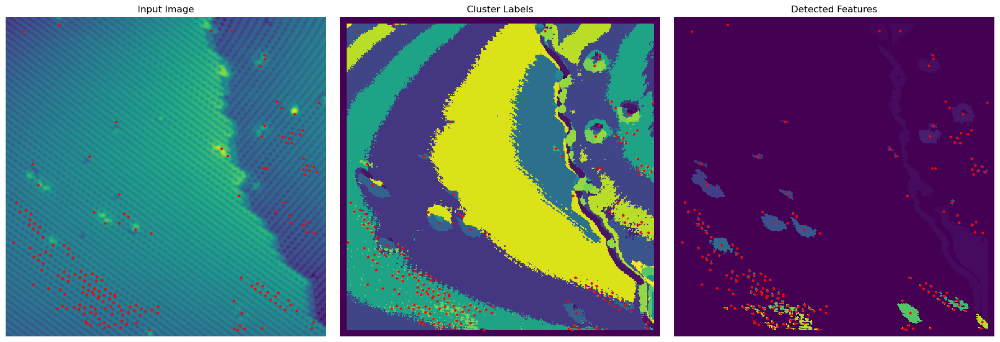


---
Processing file default_2024Aug07-153010_STM-STM_Spectroscopy--8_1_FD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


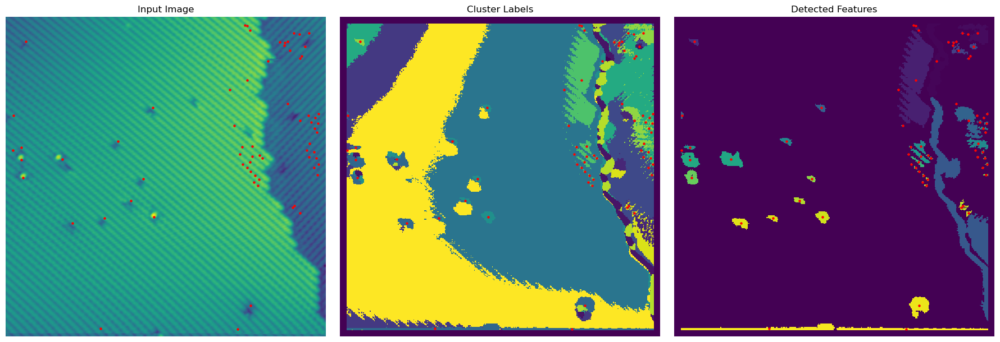


---
Processing file default_2024Aug07-153010_STM-STM_Spectroscopy--8_1_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


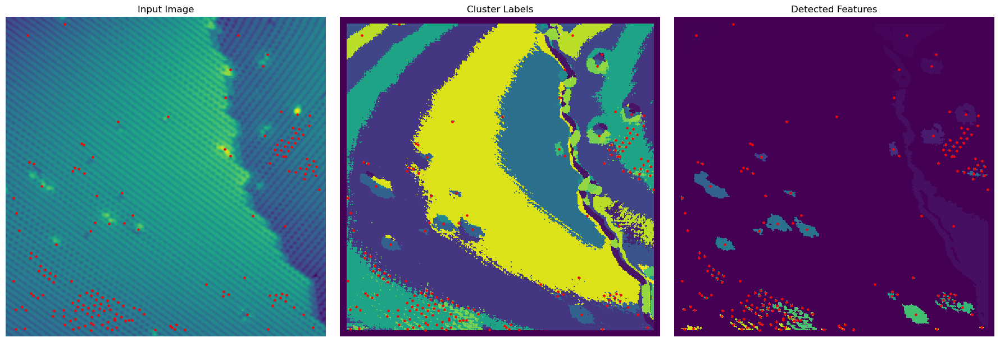


---
Processing file default_2024Aug07-153010_STM-STM_Spectroscopy--9_1_BD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


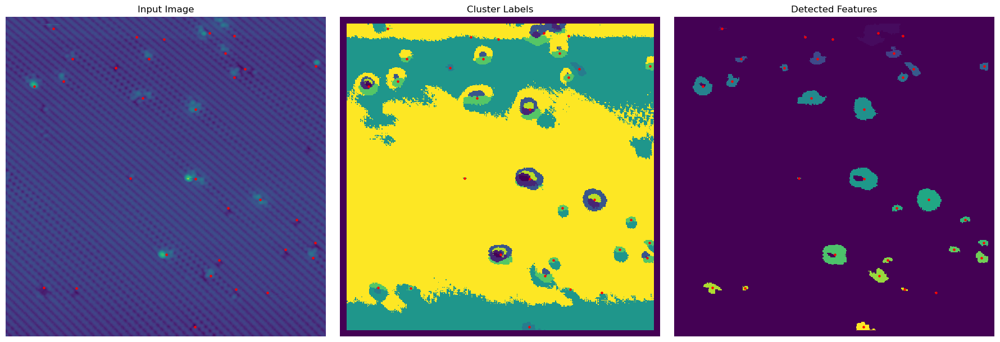


---
Processing file default_2024Aug07-153010_STM-STM_Spectroscopy--9_1_BU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


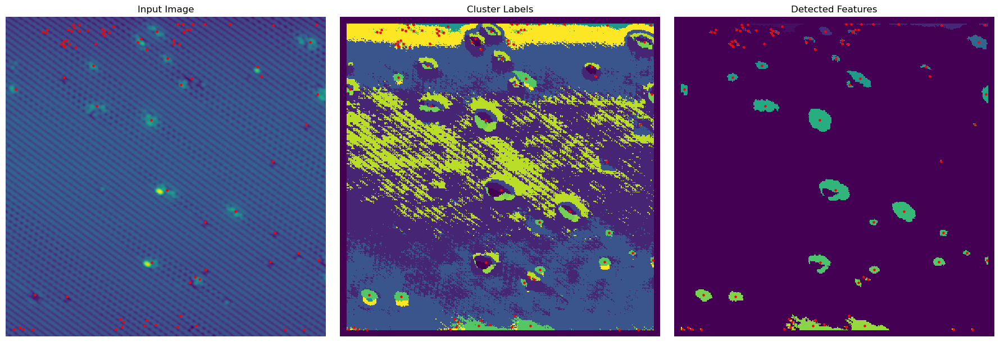


---
Processing file default_2024Aug07-153010_STM-STM_Spectroscopy--9_1_FD_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


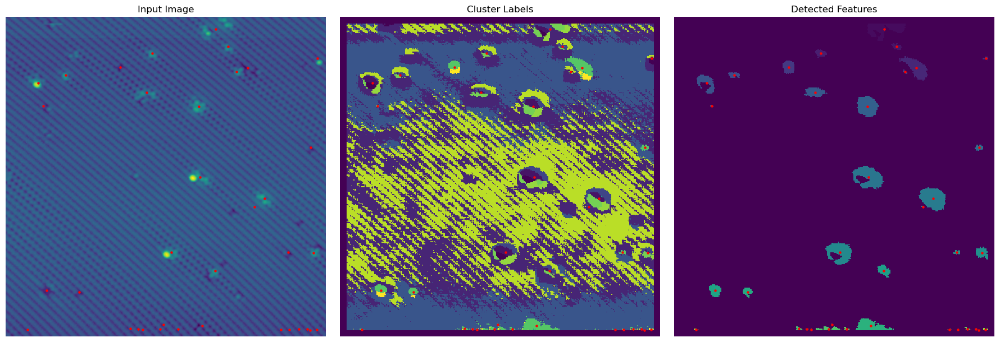


---
Processing file default_2024Aug07-153010_STM-STM_Spectroscopy--9_1_FU_all_windows.npy
Not shuffling
Data pipeline created with 1 files, batch size: 32768, window size: 32
Sample batch shape: (32768, 32, 32, 1)
....Combined latent features shape: (129600, 4096)


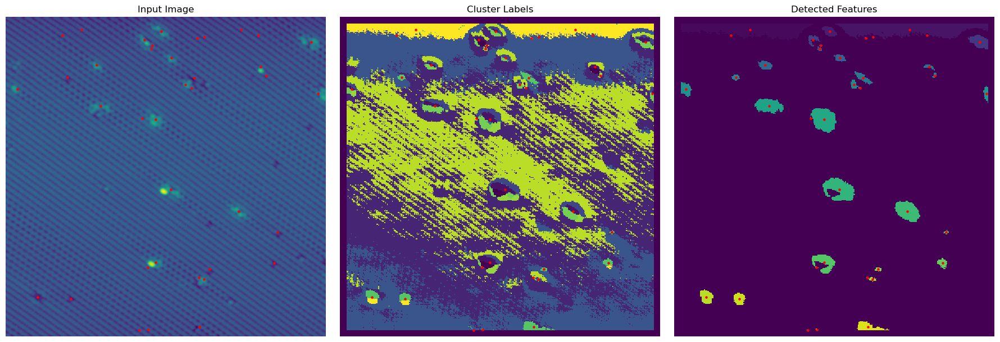

In [60]:
for image_num in range(len(predict_data_files_list)):
    prediction_file = predict_data_files_list[image_num]  
    coords_file = image_windows_coordinates_file_list[image_num]  

    #get reconstructed image and cluster image
    reconstructed_img, cluster_img = reconstruct_predict(prediction_file, coords_file, autoencoder_model, cluster_model, window_size, predictions_batch_size)

    # Detect features and find centers
    features, centers, labeled_array, num_features = detect_features_find_centres(cluster_img, max_size=20000, area_threshold=10)

    display_reconstructed_and_cluster_images_and_extracted_features(
        reconstructed_img, 
        cluster_img, 
        features, 
        centers, 
        save_to_disk=False,
    )

In [87]:
ar = np.array([[0, 1,1,1,0],
              [0,0,2,2,2],
              [0,1,1,1,0],
              [0,0,0,0,0],
              [0,1,1,1,0]])

#b = morphology.remove_small_objects(ar, min_size=7, connectivity=0)
b= remove_small_objects(ar, min_size=9)
print(b)

[[0 1 1 1 0]
 [0 0 0 0 0]
 [0 1 1 1 0]
 [0 0 0 0 0]
 [0 1 1 1 0]]


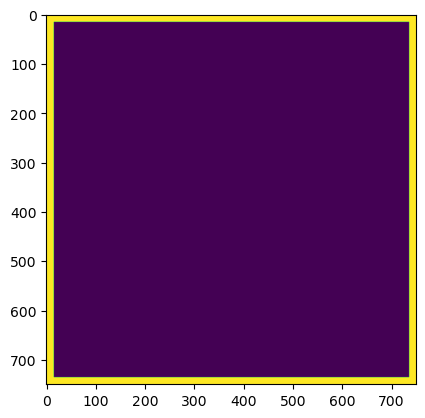

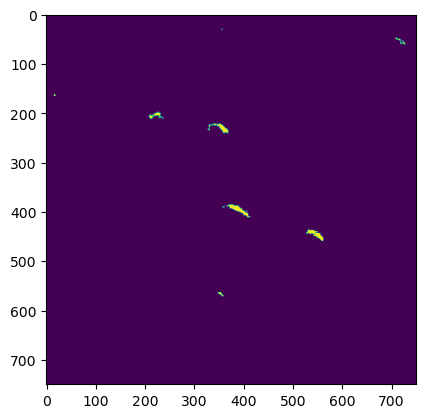

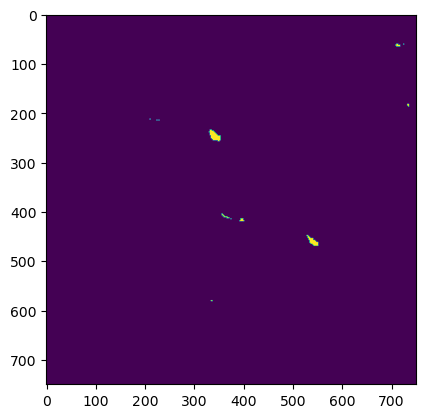

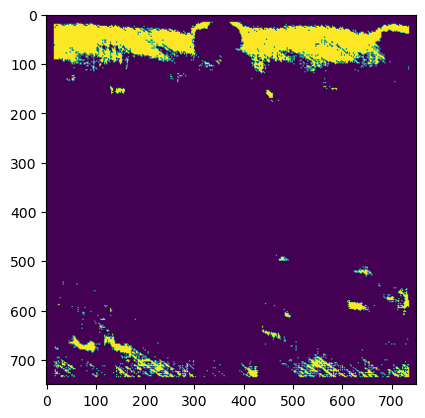

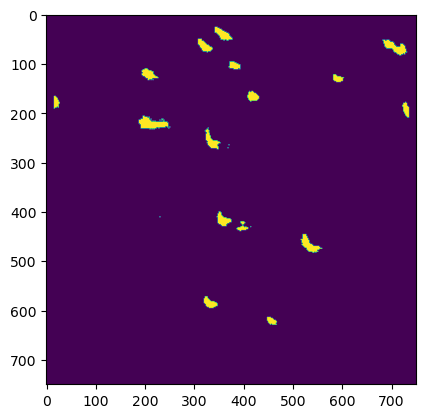

...

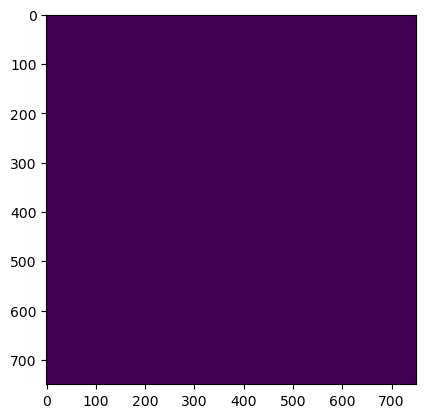

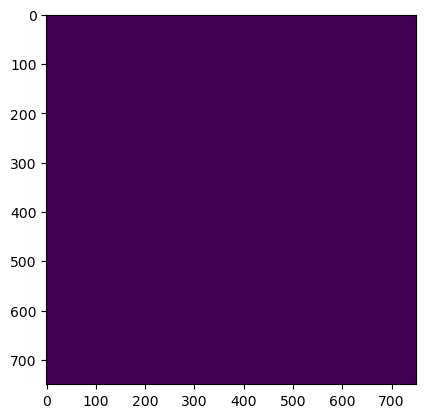

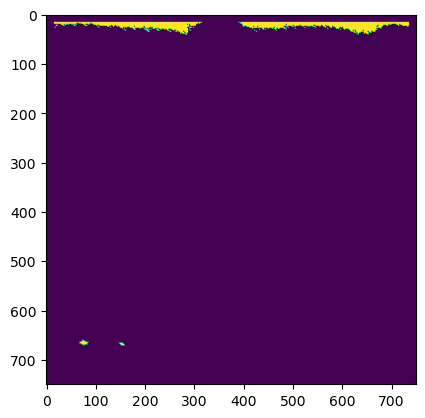

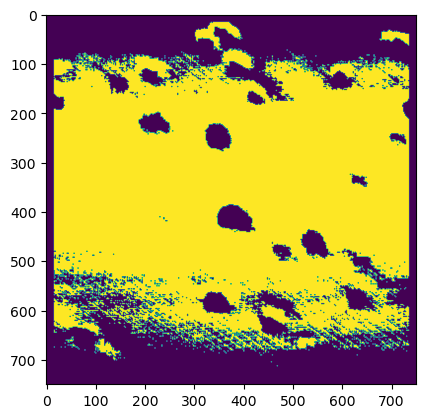

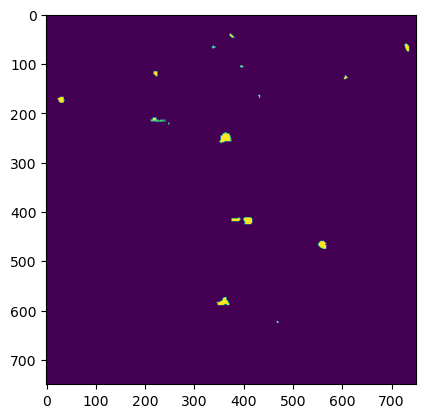

In [28]:
for i in range(int(np.max(cluster_img))+1):
    plt.imshow(cluster_img==i, cmap='viridis')
    plt.show()